In [1]:
import pandas as pd
import os
import numpy as np
from scipy.signal import butter, filtfilt
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from colorspacious import cspace_convert
import colorsys
#import librosa
from itertools import groupby
from scipy.stats import pearsonr

In [2]:
!rm -rf `find -L -type d -name .ipynb_checkpoints`

In [3]:
path_speaker6=r'motionspeaker/motionspeaker/6m/speaker'
folder_speaker6=os.listdir(path_speaker6)
folder_speaker6.sort()

In [4]:
path_speaker9=r'motionspeaker/motionspeaker/9m/speaker'
folder_speaker9=os.listdir(path_speaker9)
folder_speaker9.sort()

In [5]:
path_speaker12=r'motionspeaker/motionspeaker/12m/speaker'
folder_speaker12=os.listdir(path_speaker12)
folder_speaker12.sort()

In [6]:
matchlabelall=[]
matchidall=[] #6m,9m,12m

matchlabelall69=[]
matchidall69=[] 

matchlabelall612=[]
matchidall612=[] 

matchlabelall912=[]
matchidall912=[] 
for i in range(len(folder_speaker6)):
    tem9=np.where(np.array(folder_speaker9)==folder_speaker6[i])[0]
    tem12=np.where(np.array(folder_speaker12)==folder_speaker6[i])[0]
    if len(tem9)!=0:
        matchlabelall69.append(folder_speaker6[i])
        tem=np.c_[i,tem9[0]]
        matchidall69.append(tem)
    if len(tem12)!=0:
        matchlabelall612.append(folder_speaker6[i])
        tem=np.c_[i,tem12[0]]
        matchidall612.append(tem)
    if len(tem9)!=0 and len(tem12)!=0:
        matchlabelall.append(folder_speaker6[i])
        tem=np.c_[i,tem9[0],tem12[0]]
        matchidall.append(tem)
for i in range(len(folder_speaker9)):
    tem12=np.where(np.array(folder_speaker12)==folder_speaker9[i])[0]
    if len(tem12)!=0:
        matchlabelall912.append(folder_speaker9[i])
        tem=np.c_[i,tem12[0]]
        matchidall912.append(tem)

In [7]:
sample_rate=52

In [8]:
def downsample_to_mean(datain, original_fs, new_interval):   
    """
    Downsamples the data by calculating the mean value of each window.
    
    Parameters:
    data (numpy array): The original data to be downsampled.
    original_fs (int): The original sampling frequency (in Hz).
    new_interval (int): The new sampling interval (in seconds).

    Returns:
    numpy array: The downsampled data.
    """
    data=np.array(datain)
    # Calculate the number of samples in each new sample interval
    samples_per_window = original_fs * new_interval
    
    # Ensure the data length is a multiple of samples_per_window
    n_windows = len(data) // samples_per_window
    
    # Reshape data into windows
    reshaped_data = data[:n_windows * samples_per_window].reshape(-1, samples_per_window)
    
    # Calculate the mean of each window
    downsampled_data = reshaped_data.mean(axis=1)
    
    return downsampled_data


In [9]:
def downall(scorein):
    sample_rate=52
    new_sample1s=1
    new_sample10s=10
    new_sample1m=60
    new_sample10m=600
    new_sample30m=1800
    sec1out=[]
    sec10out=[]
    min1out=[]
    min10out=[]
    min30out=[]
    for i in range(len(scorein)):
        scores1sec=downsample_to_mean(scorein[i], sample_rate, new_sample1s)
        sec1out.append(scores1sec)
        scores10sec=downsample_to_mean(scorein[i], sample_rate, new_sample10s)
        sec10out.append(scores10sec)
        scores1min=downsample_to_mean(scorein[i], sample_rate, new_sample1m)
        min1out.append(scores1min)
        scores10min=downsample_to_mean(scorein[i], sample_rate, new_sample10m)
        min10out.append(scores10min)
        scores30min=downsample_to_mean(scorein[i], sample_rate, new_sample30m)
        min30out.append(scores30min)
    return sec1out,sec10out,min1out,min10out,min30out

In [10]:
import csv
# Define the directory and filename
directory = 'coincidence/data'
all6name = 'alls6.csv'
all9name = 'alls9.csv'
all12name = 'alls12.csv'

file_path6 = os.path.join(directory, all6name)
file_path9 = os.path.join(directory, all9name)
file_path12 = os.path.join(directory, all12name)

def convert_item(item):
    try:
        return int(item)
    except ValueError:
        try:
            return float(item)
        except ValueError:
            return item
# Save the list to the CSV file
all_s6 = []
with open(file_path6, 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        converted_row = [convert_item(item) for item in row]
        all_s6.append(converted_row)  # Or convert items to their appropriate types
# Save the list to the CSV file
all_s9 = []
with open(file_path9, 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        converted_row = [convert_item(item) for item in row]
        all_s9.append(converted_row)  # Or convert items to their appropriate types
# Save the list to the CSV file
all_s12 = []
with open(file_path12, 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        converted_row = [convert_item(item) for item in row]
        all_s12.append(converted_row)  # Or convert items to their appropriate types

In [11]:
sec1out6,sec10out6,min1out6,min10out6,min30out6=downall(all_s6)
sec1out9,sec10out9,min1out9,min10out9,min30out9=downall(all_s9)
sec1out12,sec10out12,min1out12,min10out12,min30out12=downall(all_s12)

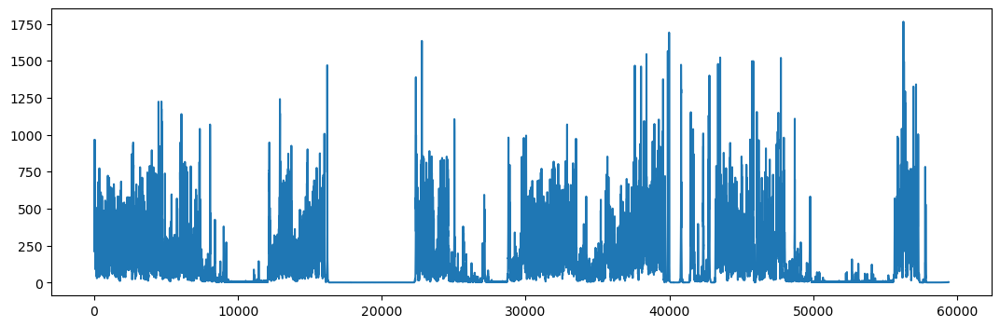

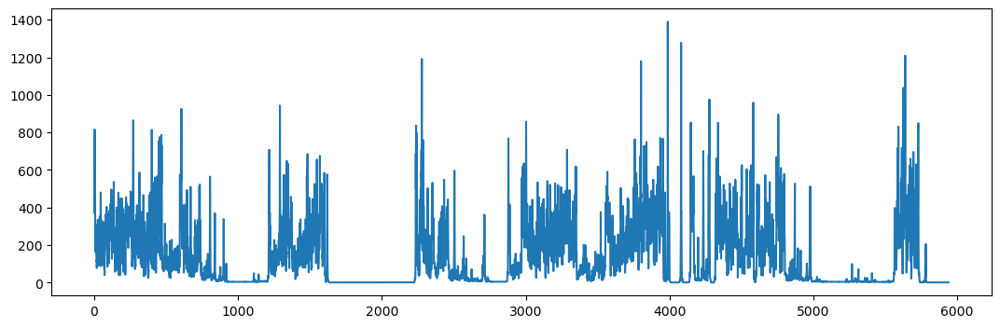

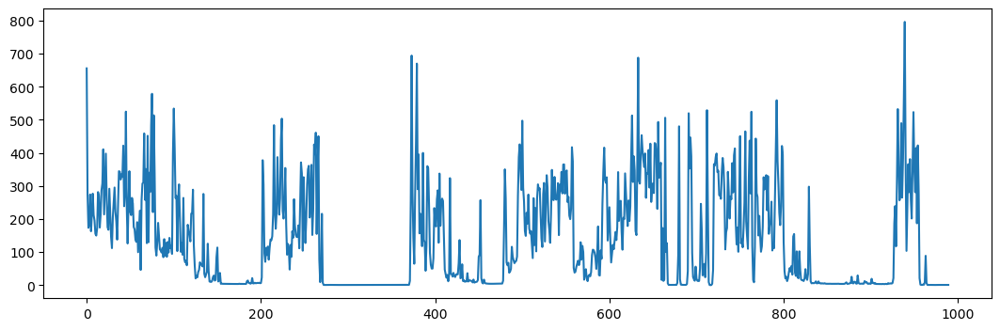

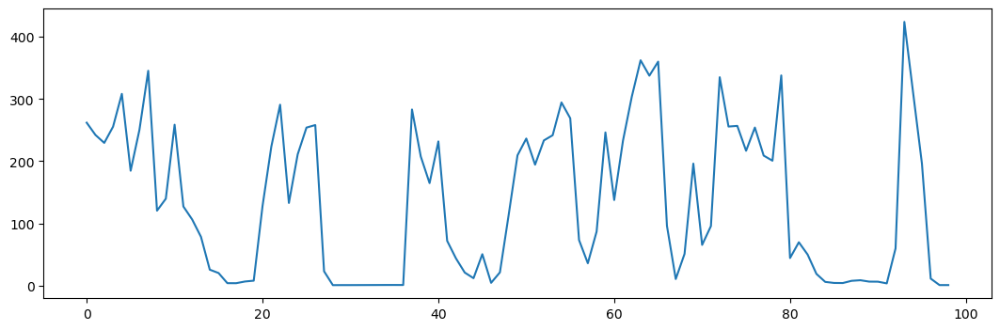

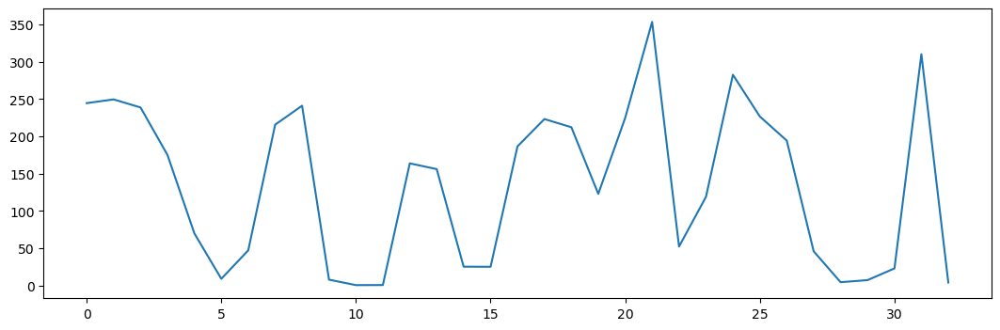

In [37]:
plt.figure(figsize=(13, 4))
plt.plot(sec1out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(sec10out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(min1out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(min10out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(min30out6[-1])
plt.show()

In [38]:
def voc(dfin):
    second_counts = dfin['Second'].value_counts().sort_index()
    tensecond_counts = dfin['TenSecond'].value_counts().sort_index()
    minute_counts = dfin['Minute'].value_counts().sort_index()
    tenminute_counts = dfin['TenMinute'].value_counts().sort_index()
    thirtyminute_counts = dfin['ThirtyMinute'].value_counts().sort_index()
    # Create numpy arrays for each interval
    max_second = dfin['Second'].max() + 1
    max_tensecond = dfin['TenSecond'].max() + 1
    max_minute = dfin['Minute'].max() + 1
    max_tenminute = dfin['TenMinute'].max() + 1
    max_thirtyminute = dfin['ThirtyMinute'].max() + 1

    second_array = np.zeros(max_second, dtype=int)
    tensecond_array = np.zeros(max_tensecond, dtype=int)
    minute_array = np.zeros(max_minute, dtype=int)
    tenminute_array = np.zeros(max_tenminute, dtype=int)
    thirtyminute_array = np.zeros(max_thirtyminute, dtype=int)
    second_array[second_counts.index] = second_counts.values
    tensecond_array[tensecond_counts.index] = tensecond_counts.values
    minute_array[minute_counts.index] = minute_counts.values
    tenminute_array[tenminute_counts.index] = tenminute_counts.values
    thirtyminute_array[thirtyminute_counts.index] = thirtyminute_counts.values

    second0=np.zeros((1800))
    second0[:len(second_array)]=second_array
    second100=np.zeros((180))
    second100[:len(tensecond_array)]=tensecond_array
    min0=np.zeros((30))
    min0[:len(minute_array)]=minute_array
    min100=np.zeros((3))
    min100[:len(tenminute_array)]=tenminute_array
    min300=np.zeros((1))
    min300[:len(thirtyminute_array)]=thirtyminute_array
    return second0,second100,min0,min100,min300

In [39]:
# Check if a specific column is empty (no non-NaN elements)
def is_column_empty(df, column_name):
    if column_name in df.columns:
        return df[column_name].dropna().empty
    else:
        return True 

In [40]:
def vocalall(path,folder):
    v1s=[]
    v10s=[]
    v1m=[]
    v10m=[]
    v30m=[]
    v1sf=[]
    v10sf=[]
    v1mf=[]
    v10mf=[]
    v30mf=[]
    for i in range(len(folder)):
        pathin_speaker=str(path+'/'+folder[i])
        files_speaker=os.listdir(path+'/'+folder[i])
        files_speaker.sort()
        count1sec=np.zeros(1800*len(files_speaker))
        count10sec=np.zeros(180*len(files_speaker))
        count1min=np.zeros(30*len(files_speaker))
        count10min=np.zeros(3*len(files_speaker))
        count30min=np.zeros(1*len(files_speaker))

        count1secf=np.zeros(1800*len(files_speaker))
        count10secf=np.zeros(180*len(files_speaker))
        count1minf=np.zeros(30*len(files_speaker))
        count10minf=np.zeros(3*len(files_speaker))
        count30minf=np.zeros(1*len(files_speaker))
        for j in range(len(files_speaker)):
            df = pd.read_csv(pathin_speaker+'/'+files_speaker[j])
            df['Starttime'] = df['Starttime'].astype(float)
            df['Second'] = df['Starttime'].astype(int)
            df['TenSecond'] = df['Second'] // 10
            df['Minute'] = df['Second'] // 60
            df['TenMinute'] = df['Second'] // (10 * 60)
            df['ThirtyMinute'] = df['Second'] // (30 * 60)
            df_kchi = df[df['Speaker'] == 'KCHI']
            df_fem = df[df['Speaker'] == 'FEM']
            #print(len(df_kchi['Speaker']))
            if len(df_kchi['Speaker'])==0:
                second0c=0
                second10c=0
                min0c=0
                min100c=0
                min300c=0
            else:
                second0c,second10c,min0c,min100c,min300c=voc(df_kchi)
            if len(df_fem['Speaker'])==0:
                second0f=0
                second10f=0
                min0f=0
                min100f=0
                min300f=0
            else:
                second0f,second10f,min0f,min100f,min300f=voc(df_fem)
            count1sec[j*1800:(j+1)*1800]=second0c
            count10sec[j*180:(j+1)*180]=second10c
            count1min[j*30:(j+1)*30]=min0c
            count10min[j*3:(j+1)*3]=min100c
            count30min[j*1:(j+1)*1]=min300c
            count1secf[j*1800:(j+1)*1800]=second0f
            count10secf[j*180:(j+1)*180]=second10f
            count1minf[j*30:(j+1)*30]=min0f
            count10minf[j*3:(j+1)*3]=min100f
            count30minf[j*1:(j+1)*1]=min300f
        v1s.append(count1sec)
        v10s.append(count10sec)
        v1m.append(count1min)
        v10m.append(count10min)
        v30m.append(count30min)
        v1sf.append(count1secf)
        v10sf.append(count10secf)
        v1mf.append(count1minf)
        v10mf.append(count10minf)
        v30mf.append(count30minf)
    return v1s,v10s,v1m,v10m,v30m,v1sf,v10sf,v1mf,v10mf,v30mf

In [41]:
v1s6,v10s6,v1m6,v10m6,v30m6,v1sf6,v10sf6,v1mf6,v10mf6,v30mf6=vocalall(path_speaker6,folder_speaker6)
v1s9,v10s9,v1m9,v10m9,v30m9,v1sf9,v10sf9,v1mf9,v10mf9,v30mf9=vocalall(path_speaker9,folder_speaker9)
v1s12,v10s12,v1m12,v10m12,v30m12,v1sf12,v10sf12,v1mf12,v10mf12,v30mf12=vocalall(path_speaker12,folder_speaker12)

In [42]:
def matching(vin,vinf,sin):
    sout=[]
    vout=[]
    voutf=[]
    for i in range(len(sin)):
        if len(sin[i])>=len(vin[i]):
            stem=sin[i][:len(vin[i])]
            sout.append(stem)
            vout.append(vin[i])
            voutf.append(vinf[i])
        else:
            vtem=vin[i][:len(sin[i])]
            vtemf=vinf[i][:len(sin[i])]
            vout.append(vtem)
            voutf.append(vtemf[i])
            sout.append(sin[i])
    return sout, vout,voutf

In [43]:
s1s6o,v1s6o,v1s6fo=matching(v1s6,v1sf6,sec1out6)
s1s9o,v1s9o,v1s9fo=matching(v1s9,v1sf9,sec1out9)
s1s12o,v1s12o,v1s12fo=matching(v1s12,v1sf12,sec1out12)

In [44]:
s10s6o,v10s6o,v10s6fo=matching(v10s6,v10sf6,sec10out6)
s10s9o,v10s9o,v10s9fo=matching(v10s9,v10sf9,sec10out9)
s10s12o,v10s12o,v10s12fo=matching(v10s12,v10sf12,sec10out12)

In [45]:
s1m6o,v1m6o,v1m6fo=matching(v1m6,v1mf6,min1out6)
s1m9o,v1m9o,v1m9fo=matching(v1m9,v1mf9,min1out9)
s1m12o,v1m12o,v1m12fo=matching(v1m12,v1mf12,min1out12)

In [46]:
s10m6o,v10m6o,v10m6fo=matching(v10m6,v10mf6,min10out6)
s10m9o,v10m9o,v10m9fo=matching(v10m9,v10mf9,min10out9)
s10m12o,v10m12o,v10m12fo=matching(v10m12,v10mf12,min10out12)

In [47]:
s30m6o,v30m6o,v30m6fo=matching(v30m6,v30mf6,min30out6)
s30m9o,v30m9o,v30m9fo=matching(v30m9,v30mf9,min30out9)
s30m12o,v30m12o,v30m12fo=matching(v30m12,v30mf12,min30out12)

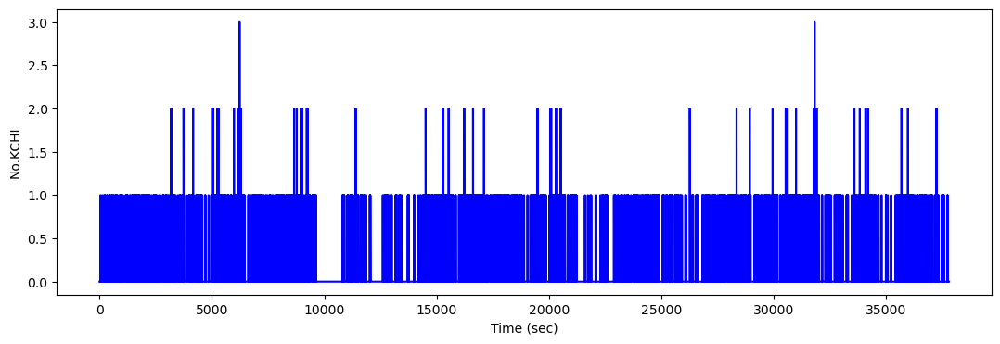

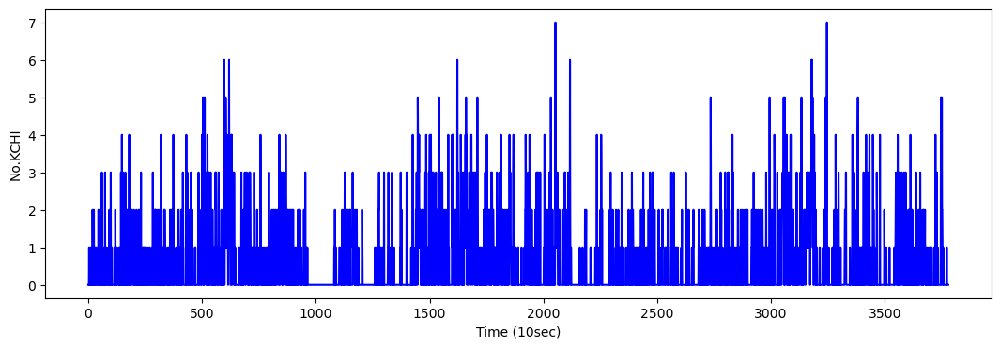

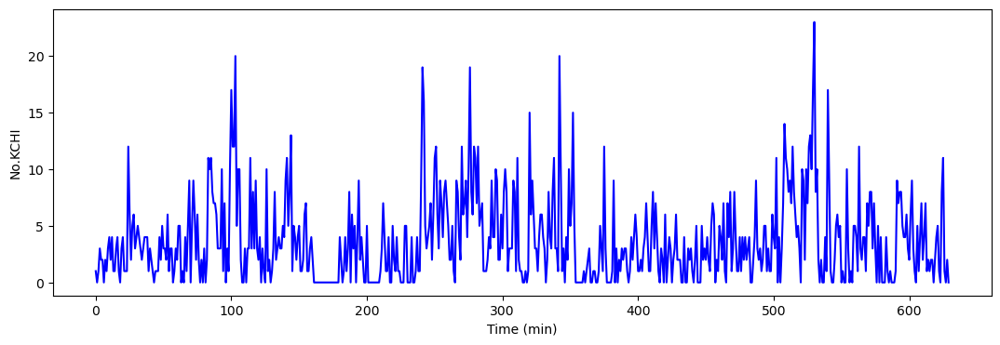

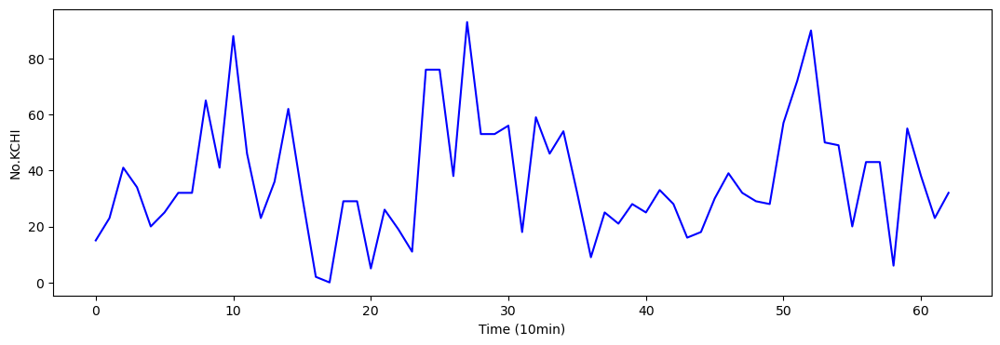

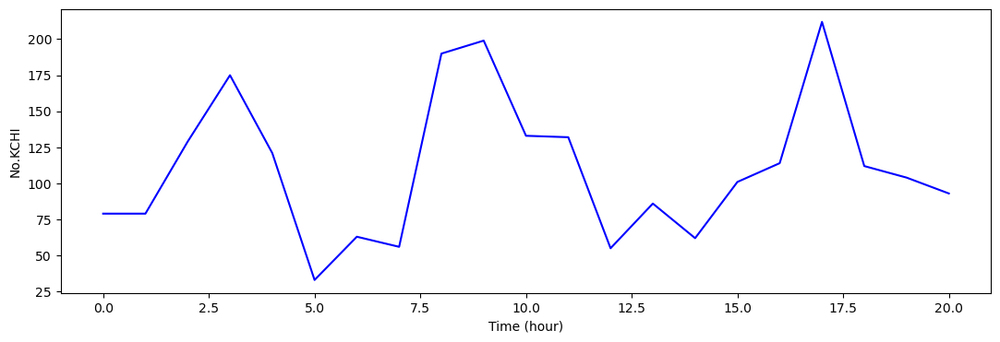

In [48]:
plt.figure(figsize=(13, 4))
plt.plot( v1s12[15], color='b')
plt.xlabel('Time (sec)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v10s12[15], color='b')
plt.xlabel('Time (10sec)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v1m12[15], color='b')
plt.xlabel('Time (min)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v10m12[15], color='b')
plt.xlabel('Time (10min)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v30m12[15], color='b')
plt.xlabel('Time (hour)')
plt.ylabel('No.KCHI')
plt.show()

In [49]:
def remove0(sin,vcin,vmin):
    sout=[]
    vcout=[]
    vmout=[]
    for i in range(len(sin)):
        #print(i)
        sout.append(sin[i][np.where(sin[i]>5)[0]])
        vcout.append(vcin[i][np.where(sin[i]>5)[0]])
        vmout.append(vmin[i][np.where(sin[i]>5)[0]])
    return sout,vcout, vmout

In [50]:
s1s6os,v1s6os,v1s6fos=remove0(s1s6o,v1s6o,v1s6fo)
s10s6os,v10s6os,v10s6fos=remove0(s10s6o,v10s6o,v10s6fo)
s1m6os,v1m6os,v1m6fos=remove0(s1m6o,v1m6o,v1m6fo)
s10m6os,v10m6os,v10m6fos=remove0(s10m6o,v10m6o,v10m6fo)
s30m6os,v30m6os,v30m6fos=remove0(s30m6o,v30m6o,v30m6fo)

In [51]:
s1s9os,v1s9os,v1s9fos=remove0(s1s9o,v1s9o,v1s9fo)
s10s9os,v10s9os,v10s9fos=remove0(s10s9o,v10s9o,v10s9fo)
s1m9os,v1m9os,v1m9fos=remove0(s1m9o,v1m9o,v1m9fo)
s10m9os,v10m9os,v10m9fos=remove0(s10m9o,v10m9o,v10m9fo)
s30m9os,v30m9os,v30m9fos=remove0(s30m9o,v30m9o,v30m9fo)

In [52]:
s1s12os,v1s12os,v1s12fos=remove0(s1s12o,v1s12o,v1s12fo)
s10s12os,v10s12os,v10s12fos=remove0(s10s12o,v10s12o,v10s12fo)
s1m12os,v1m12os,v1m12fos=remove0(s1m12o,v1m12o,v1m12fo)
s10m12os,v10m12os,v10m12fos=remove0(s10m12o,v10m12o,v10m12fo)
s30m12os,v30m12os,v30m12fos=remove0(s30m12o,v30m12o,v30m12fo)

In [53]:
def corrsep(sin,vin):
    corrout=np.zeros((len(sin)))
    pout=np.zeros((len(vin)))
    for i in range(len(sin)):
        corrout[i], pout[i] = pearsonr(sin[i],vin[i])
    return corrout,pout

In [56]:
corrouts1s6,pouts1s6=corrsep(s1s6o,v1s6o)
corrouts1s6f,pouts1s6f=corrsep(s1s6o,v1s6fo)

corrouts10s6,pouts10s6=corrsep(s10s6o,v10s6o)
corrouts10s6f,pouts10s6f=corrsep(s10s6o,v10s6fo)

corrouts1m6,pouts1m6=corrsep(s1m6o,v1m6o)
corrouts1m6f,pouts1m6f=corrsep(s1m6o,v1m6fo)

corrouts10m6,pouts10m6=corrsep(s10m6o,v10m6o)
corrouts10m6f,pouts10m6f=corrsep(s10m6o,v10m6fo)

corrouts30m6,pouts30m6=corrsep(s30m6o,v30m6o)
corrouts30m6f,pouts30m6f=corrsep(s30m6o,v30m6fo)

In [57]:
corrouts1s9,pouts1s9=corrsep(s1s9o,v1s9o)
corrouts1s9f,pouts1s9f=corrsep(s1s9o,v1s9fo)

corrouts10s9,pouts10s9=corrsep(s10s9o,v10s9o)
corrouts10s9f,pouts10s9f=corrsep(s10s9o,v10s9fo)

corrouts1m9,pouts1m9=corrsep(s1m9o,v1m9o)
corrouts1m9f,pouts1m9f=corrsep(s1m9o,v1m9fo)

corrouts10m9,pouts10m9=corrsep(s10m9o,v10m9o)
corrouts10m9f,pouts10m9f=corrsep(s10m9o,v10m9fo)

corrouts30m9,pouts30m9=corrsep(s30m9o,v30m9o)
corrouts30m9f,pouts30m9f=corrsep(s30m9o,v30m9fo)

In [58]:
corrouts1s12,pouts1s12=corrsep(s1s12o,v1s12o)
corrouts1s12f,pouts1s12f=corrsep(s1s12o,v1s12fo)

corrouts10s12,pouts10s12=corrsep(s10s12o,v10s12o)
corrouts10s12f,pouts10s12f=corrsep(s10s12o,v10s12fo)

corrouts1m12,pouts1m12=corrsep(s1m12o,v1m12o)
corrouts1m12f,pouts1m12f=corrsep(s1m12o,v1m12fo)

corrouts10m12,pouts10m12=corrsep(s10m12o,v10m12o)
corrouts10m12f,pouts10m12f=corrsep(s10m12o,v10m12fo)

corrouts30m12,pouts30m12=corrsep(s30m12o,v30m12o)
corrouts30m12f,pouts30m12f=corrsep(s30m12o,v30m12fo)

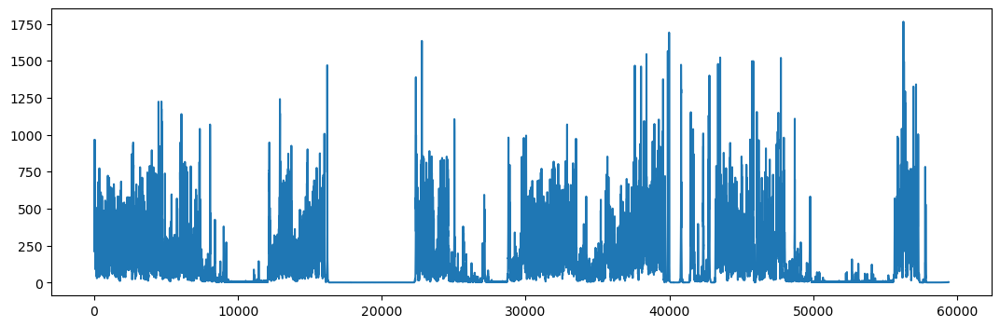

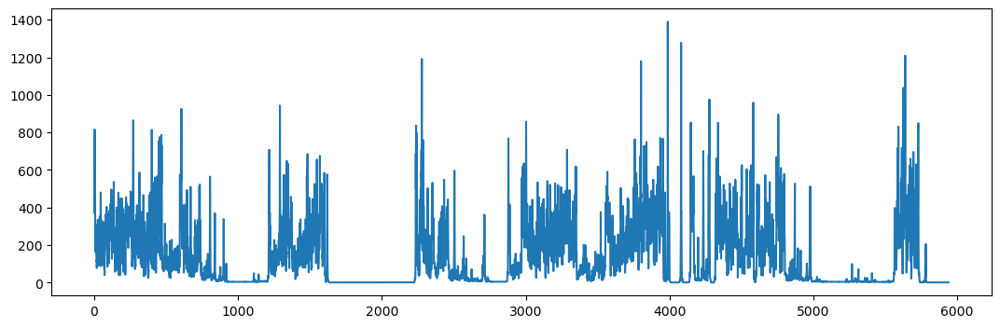

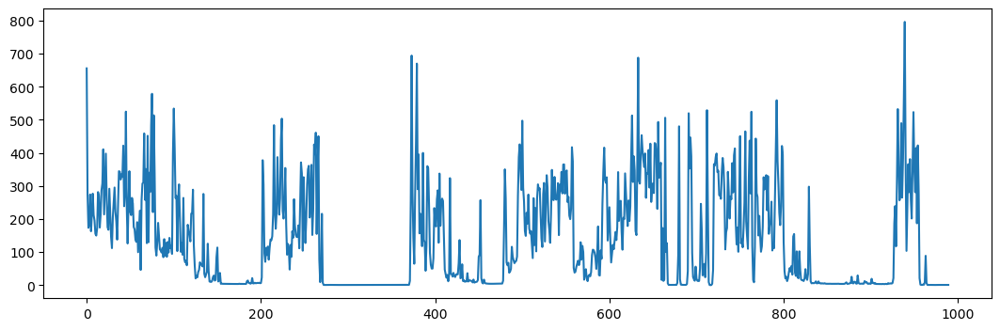

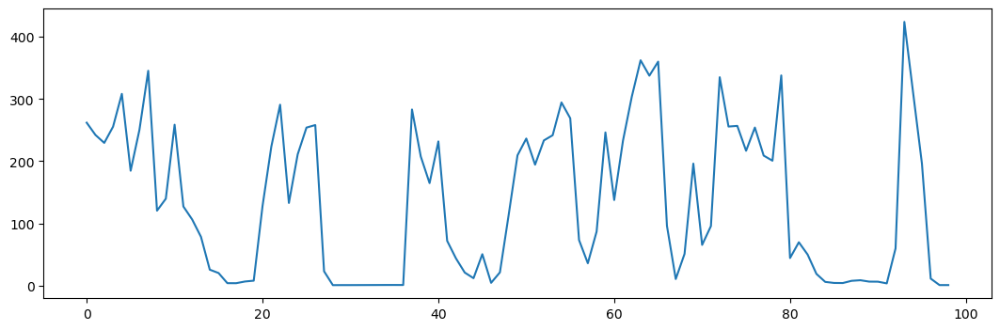

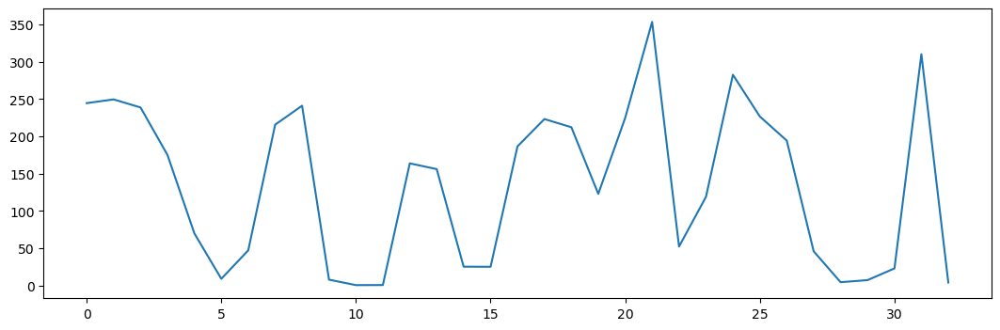

In [59]:
plt.figure(figsize=(13, 4))
plt.plot(sec1out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(sec10out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(min1out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(min10out6[-1])
plt.show()
plt.figure(figsize=(13, 4))
plt.plot(min30out6[-1])
plt.show()

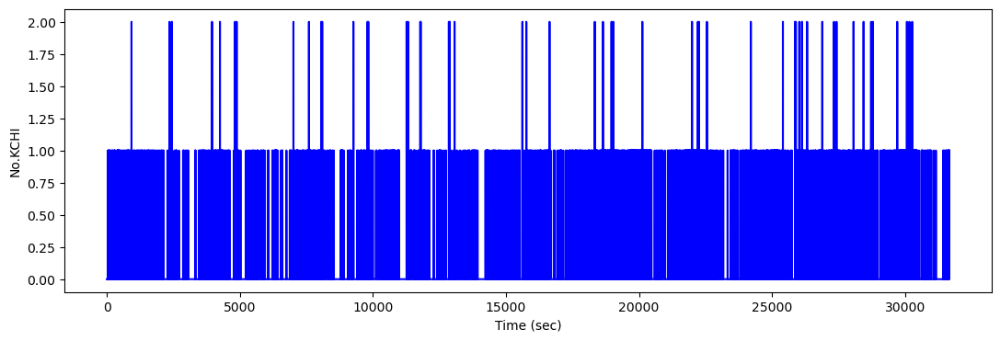

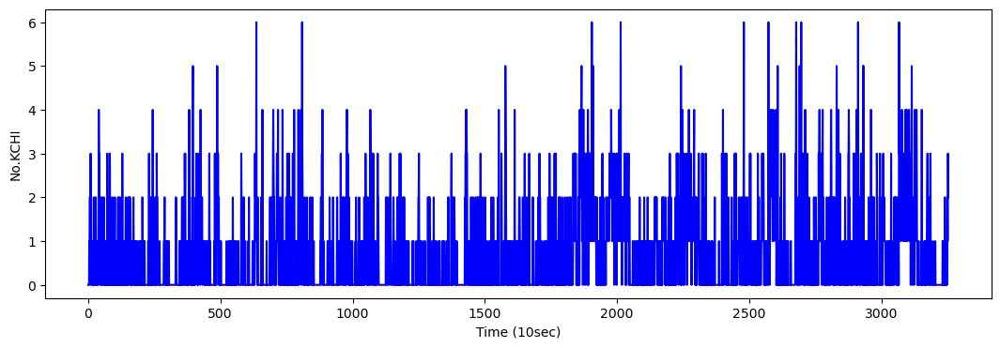

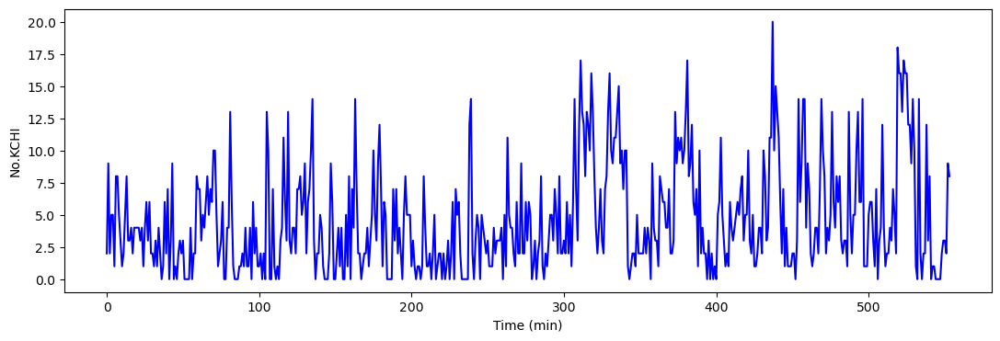

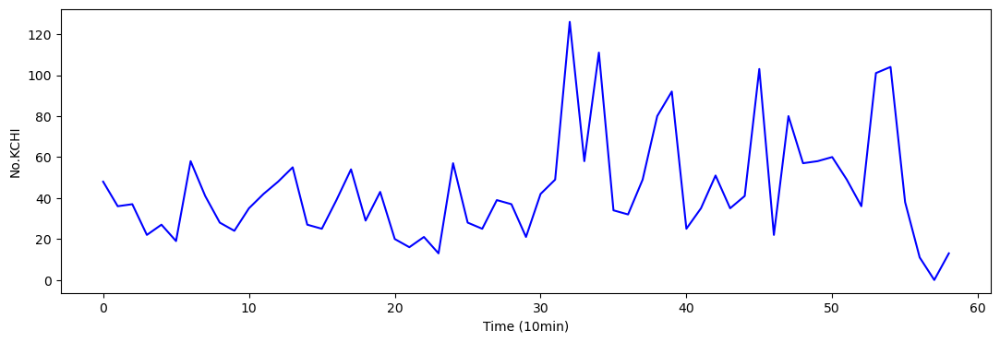

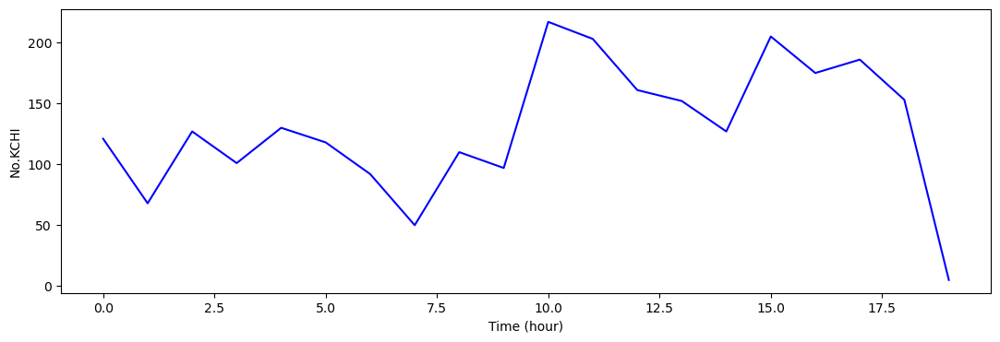

In [60]:
plt.figure(figsize=(13, 4))
plt.plot( v1s12os[4], color='b')
plt.xlabel('Time (sec)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v10s12os[4], color='b')
plt.xlabel('Time (10sec)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v1m12os[4], color='b')
plt.xlabel('Time (min)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v10m12os[4], color='b')
plt.xlabel('Time (10min)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( v30m12os[4], color='b')
plt.xlabel('Time (hour)')
plt.ylabel('No.KCHI')
plt.show()

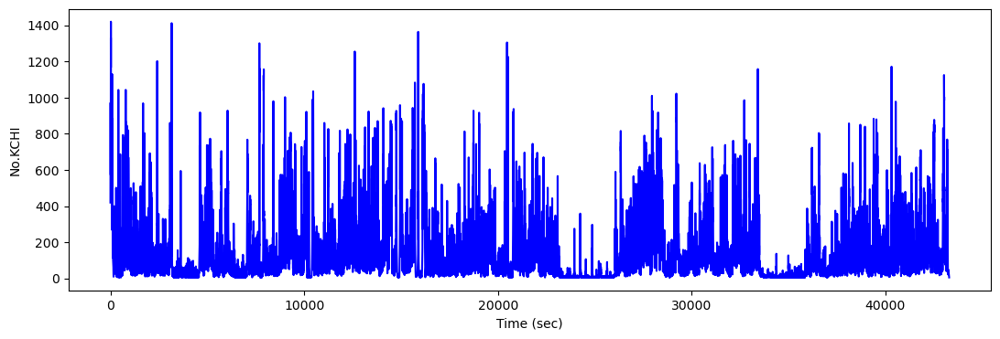

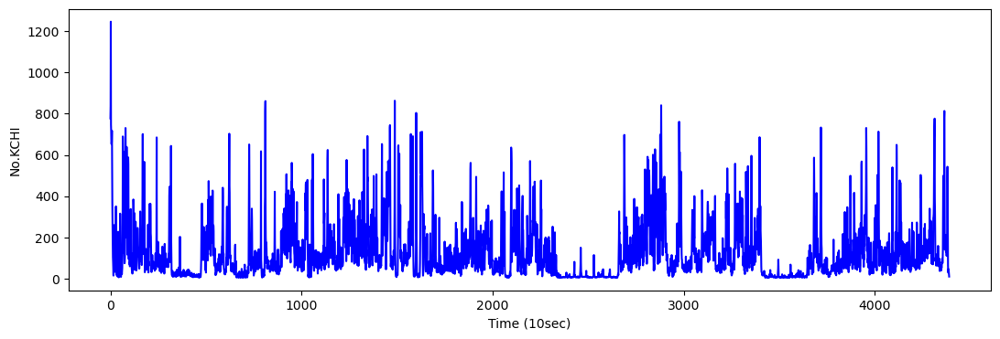

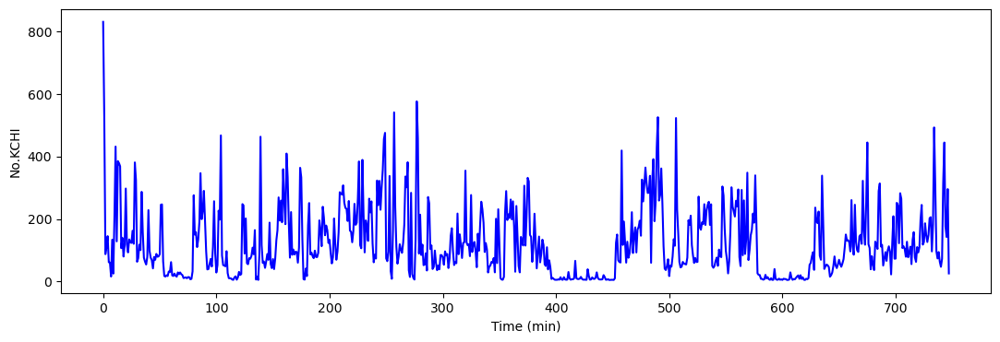

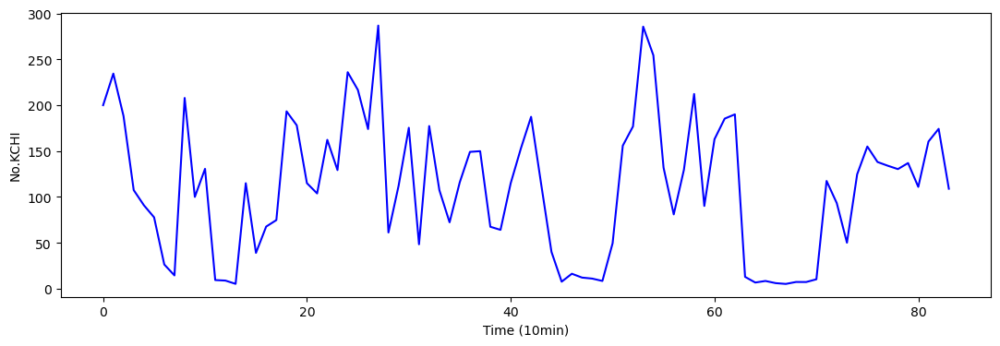

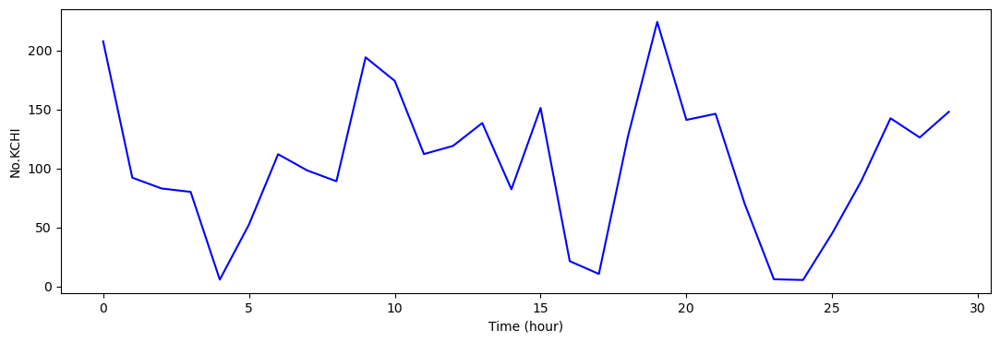

In [61]:
plt.figure(figsize=(13, 4))
plt.plot( s1s6os[1], color='b')
plt.xlabel('Time (sec)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( s10s6os[1], color='b')
plt.xlabel('Time (10sec)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( s1m6os[1], color='b')
plt.xlabel('Time (min)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( s10m6os[1], color='b')
plt.xlabel('Time (10min)')
plt.ylabel('No.KCHI')
plt.show()
plt.figure(figsize=(13, 4))
plt.plot( s30m6os[1], color='b')
plt.xlabel('Time (hour)')
plt.ylabel('No.KCHI')
plt.show()

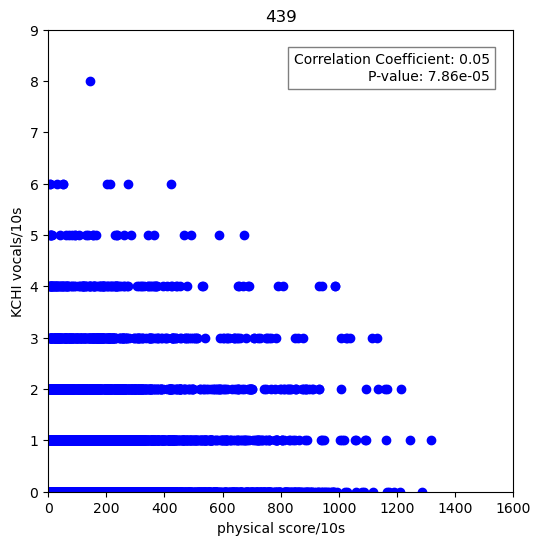

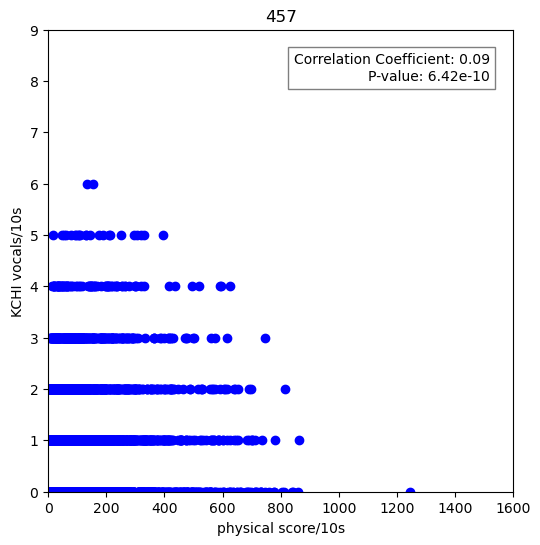

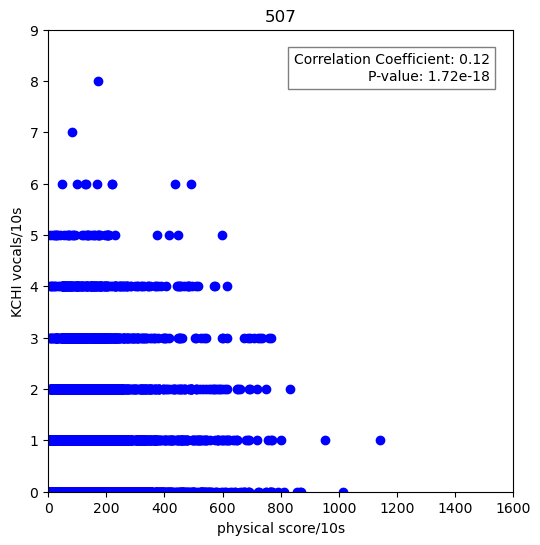

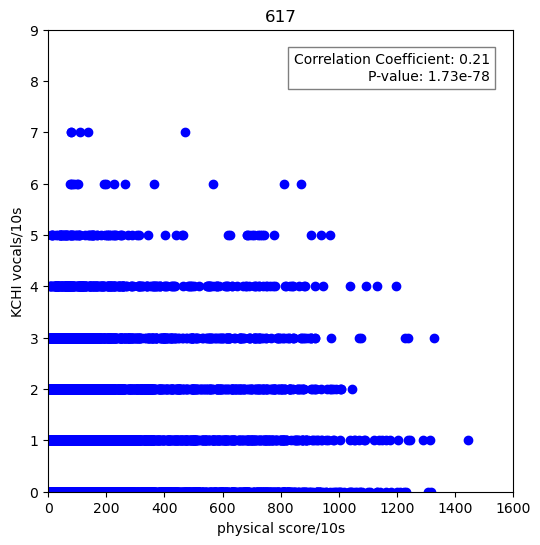

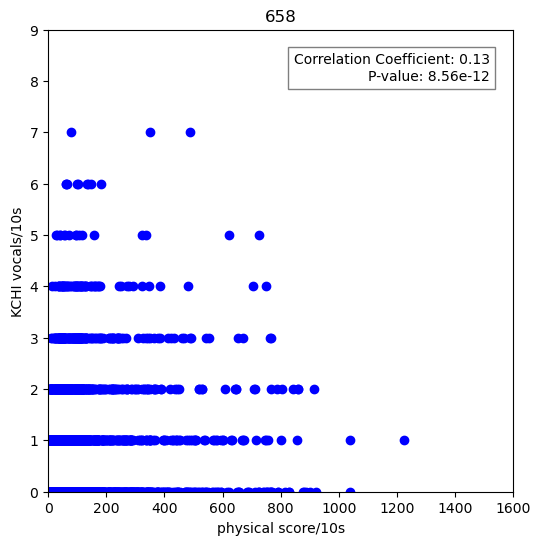

...

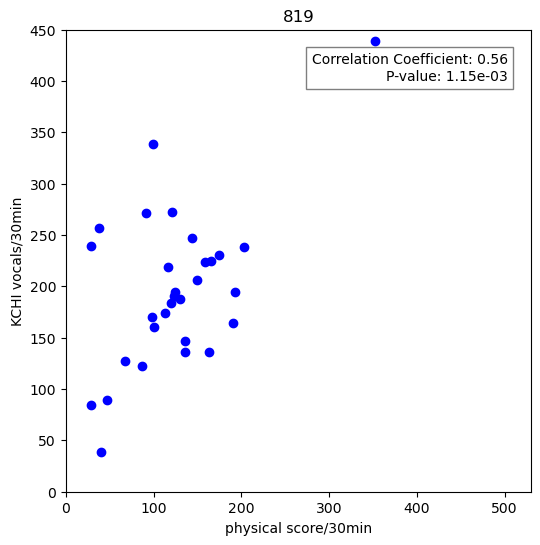

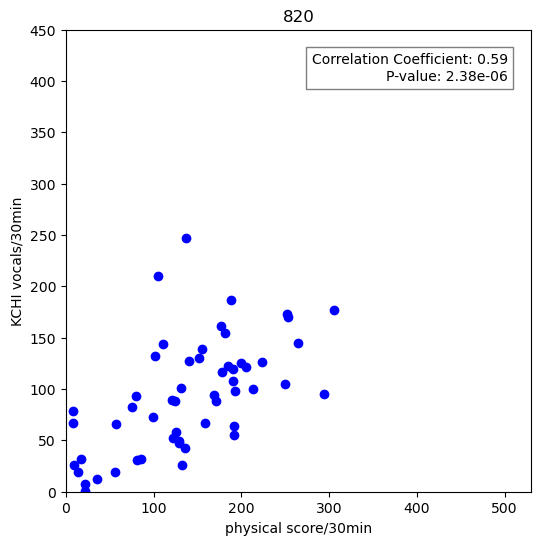

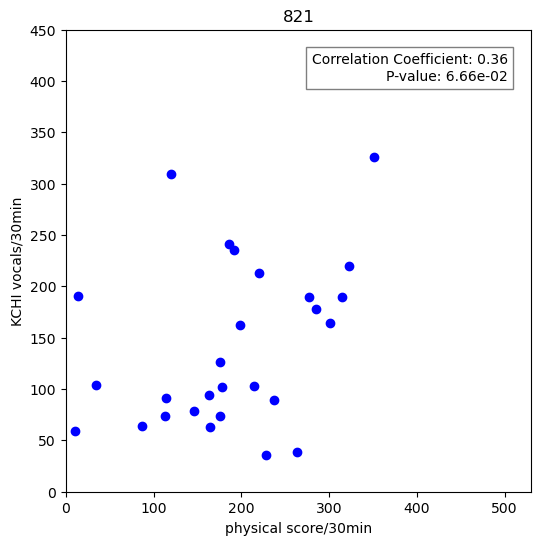

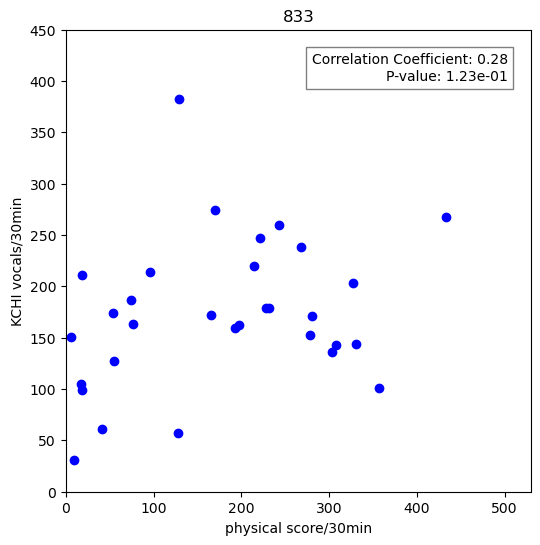

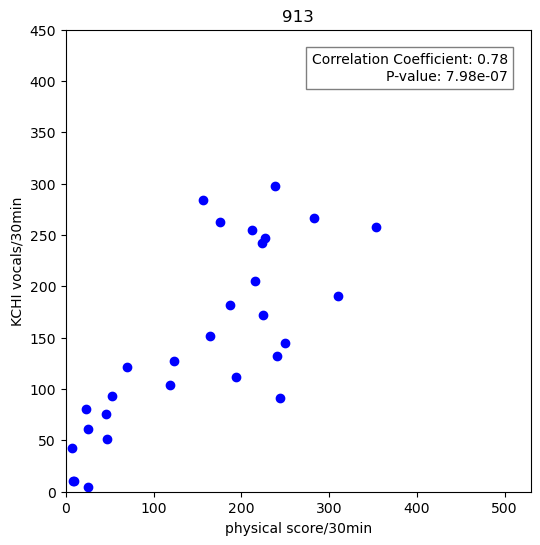

In [70]:
#10s
for i in range(len(s10s6os)):
    correlation_coefficient, p_value = pearsonr(s10s6os[i],v10s6os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10s6os[i],v10s6os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,1600)
    plt.ylim(0,9)
    plt.xlabel('physical score/10s')
    plt.ylabel('KCHI vocals/10s')
    plt.show()
    
#1m
for i in range(len(s1m6os)):
    correlation_coefficient, p_value = pearsonr(s1m6os[i],v1m6os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s1m6os[i],v1m6os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,1000)
    plt.ylim(0,30)
    plt.xlabel('physical score/1min')
    plt.ylabel('KCHI vocals/1min')
    plt.show()
    
#10m
for i in range(len(s10m6os)):
    correlation_coefficient, p_value = pearsonr(s10m6os[i],v10m6os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10m6os[i],v10m6os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,730)
    plt.ylim(0,200)
    plt.xlabel('physical score/10min')
    plt.ylabel('KCHI vocals/10min')
    plt.show()

#30m
for i in range(len(s30m6os)):
    correlation_coefficient, p_value = pearsonr(s30m6os[i],v30m6os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s30m6os[i],v30m6os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,530)
    plt.ylim(0,450)
    plt.xlabel('physical score/30min')
    plt.ylabel('KCHI vocals/30min')
    plt.show()

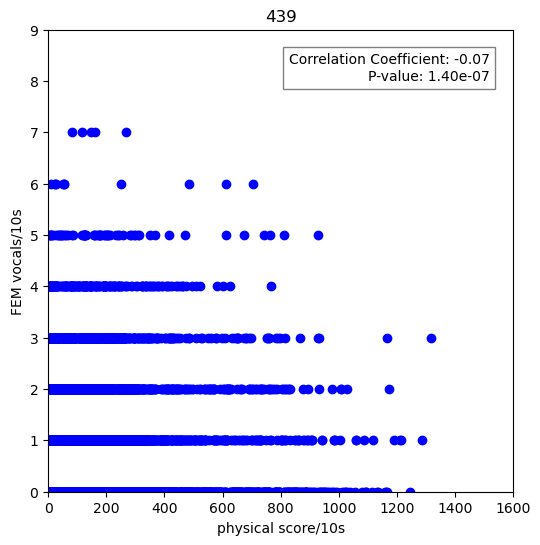

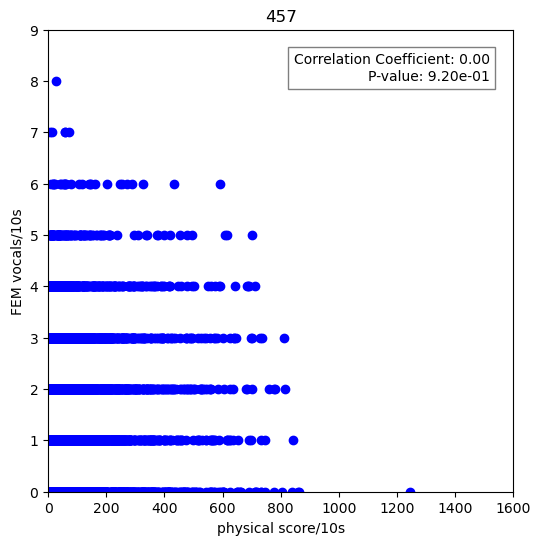

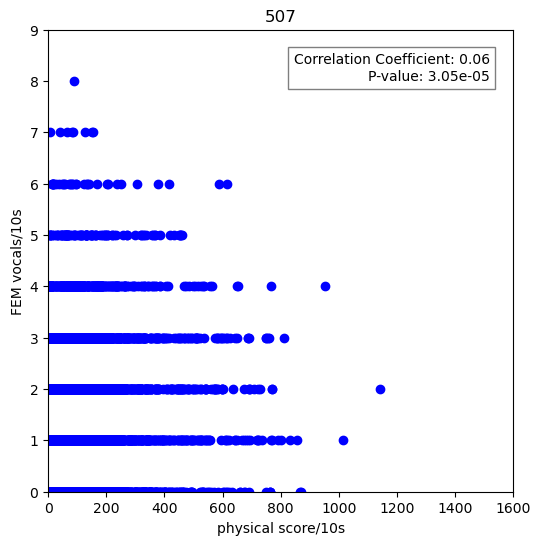

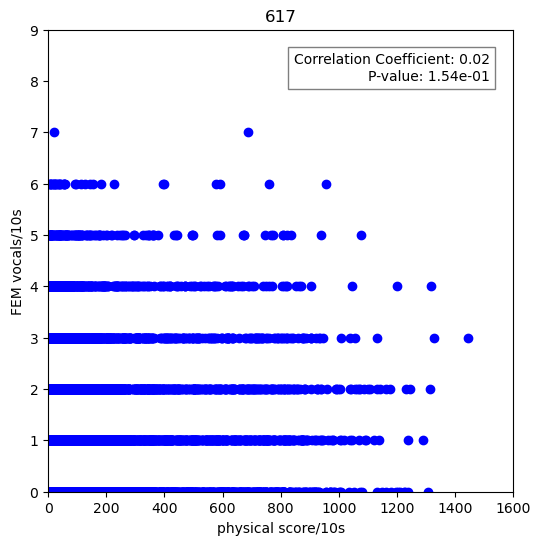

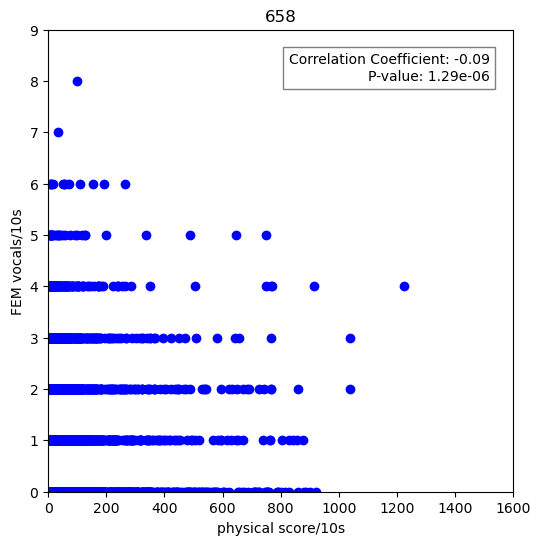

...

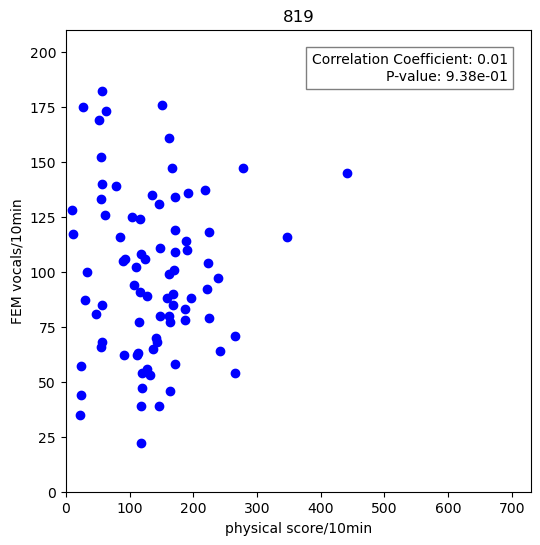

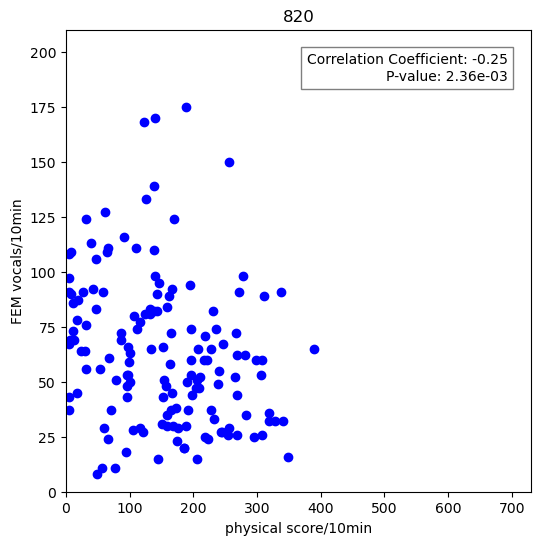

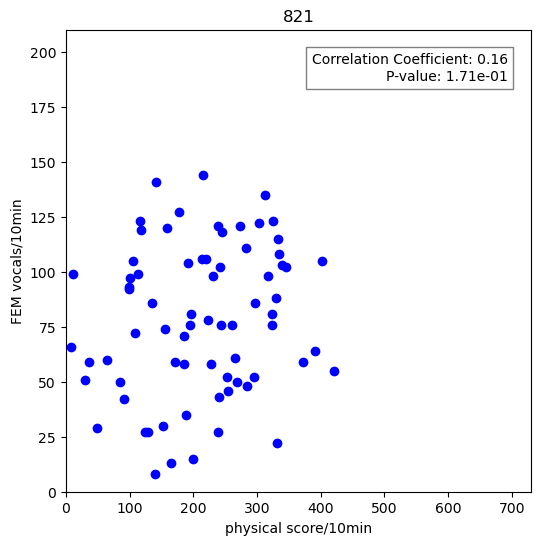

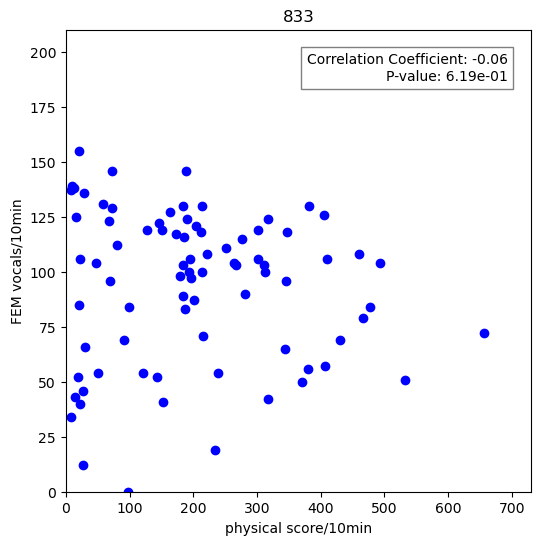

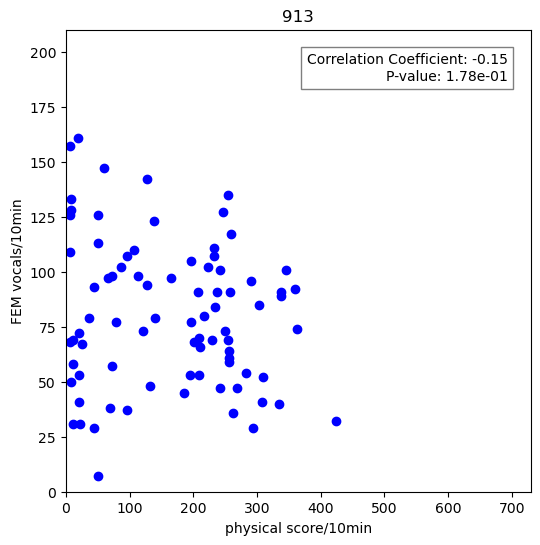

NameError: name 's30m6fos' is not defined

In [71]:
for i in range(len(s10s6os)):
    correlation_coefficient, p_value = pearsonr(s10s6os[i],v10s6fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10s6os[i],v10s6fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,1600)
    plt.ylim(0,9)
    plt.xlabel('physical score/10s')
    plt.ylabel('FEM vocals/10s')
    plt.show()
#1m
for i in range(len(s1m6os)):
    correlation_coefficient, p_value = pearsonr(s1m6os[i],v1m6fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s1m6os[i],v1m6fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,1000)
    plt.ylim(0,35)
    plt.xlabel('physical score/1min')
    plt.ylabel('FEM vocals/1min')
    plt.show()
#10m
for i in range(len(s1m6os)):
    correlation_coefficient, p_value = pearsonr(s10m6os[i],v10m6fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10m6os[i],v10m6fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,730)
    plt.ylim(0,210)
    plt.xlabel('physical score/10min')
    plt.ylabel('FEM vocals/10min')
    plt.show()
#30m
for i in range(len(s30m6fos)):
    correlation_coefficient, p_value = pearsonr(s30m6os[i],v30m6fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s30m6os[i],v30m6fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker6[i])
    plt.xlim(0,530)
    plt.ylim(0,630)
    plt.xlabel('physical score/30min')
    plt.ylabel('FEM vocals/30min')
    plt.show()

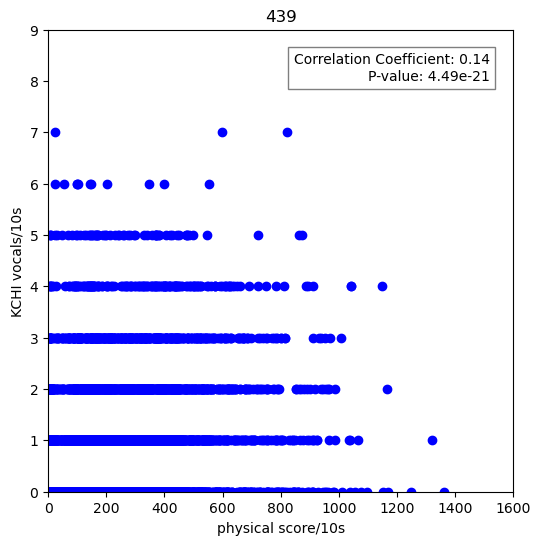

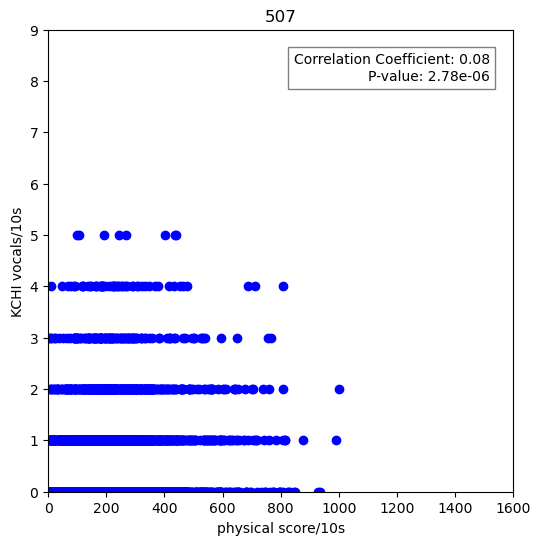

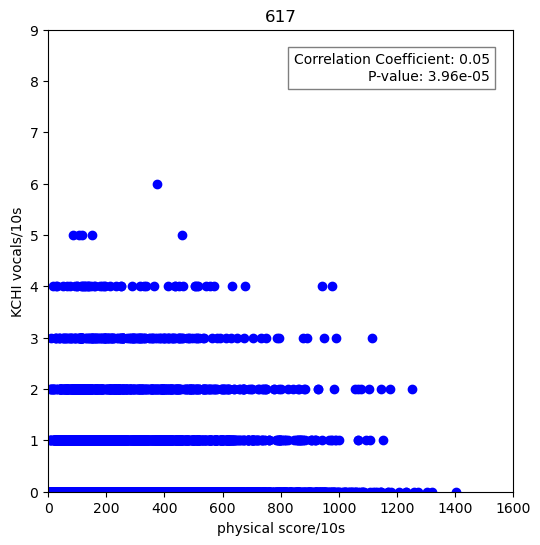

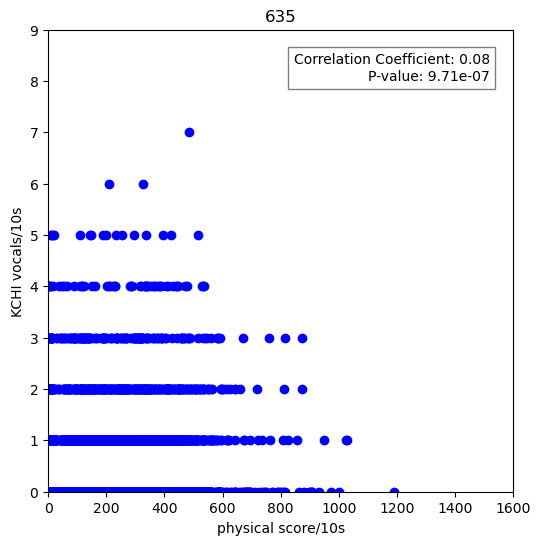

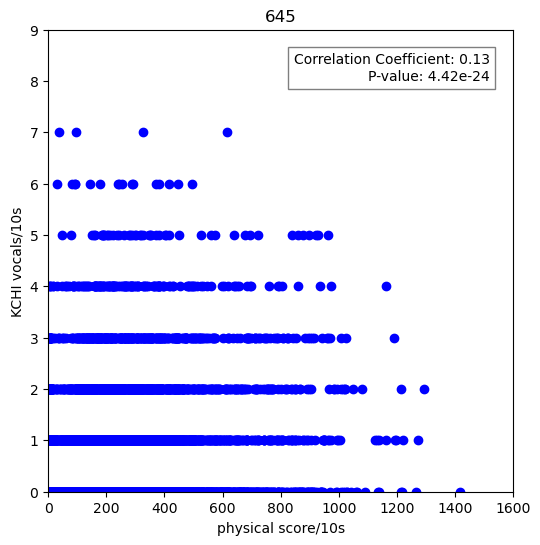

...

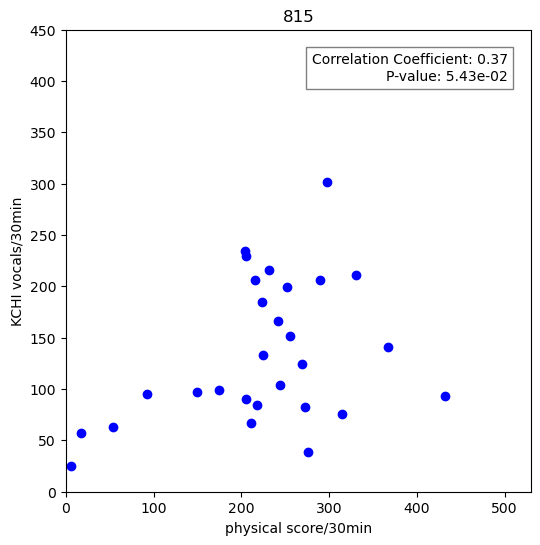

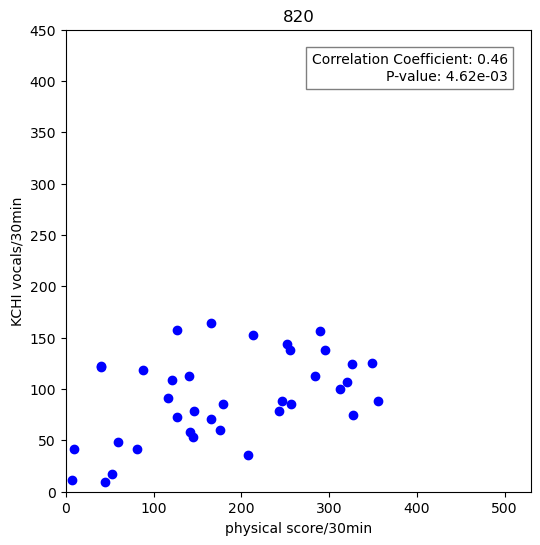

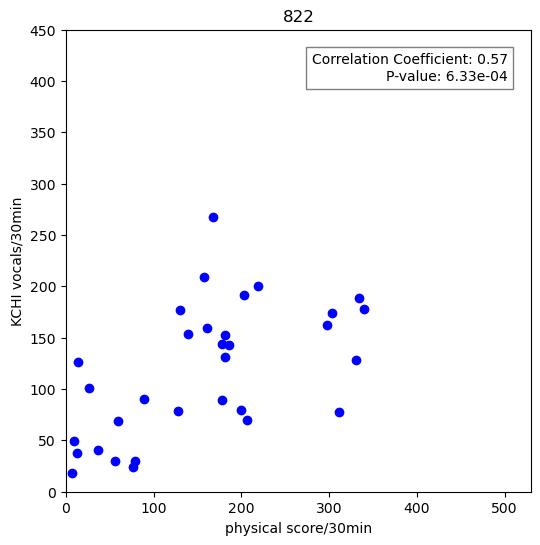

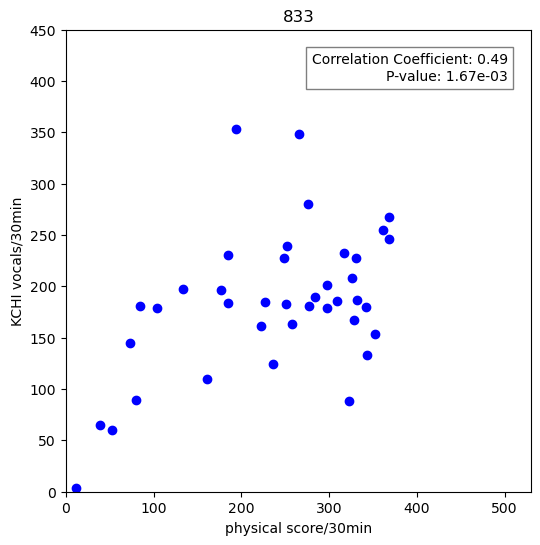

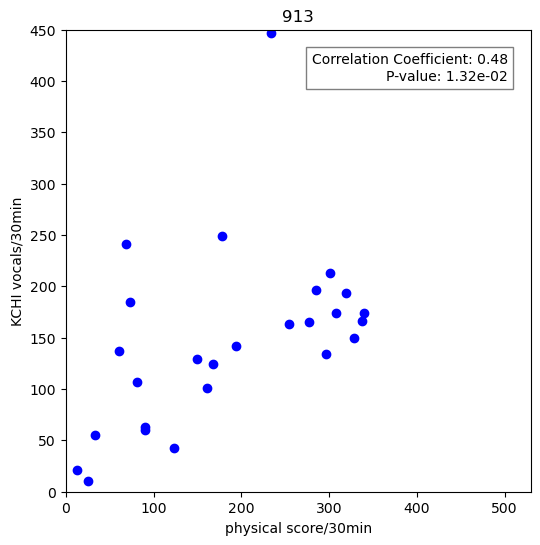

In [72]:
#10s
for i in range(len(s10s9os)):
    correlation_coefficient, p_value = pearsonr(s10s9os[i],v10s9os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10s9os[i],v10s9os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,1600)
    plt.ylim(0,9)
    plt.xlabel('physical score/10s')
    plt.ylabel('KCHI vocals/10s')
    plt.show()
    
#1m
for i in range(len(s1m9os)):
    correlation_coefficient, p_value = pearsonr(s1m9os[i],v1m9os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s1m9os[i],v1m9os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,1000)
    plt.ylim(0,30)
    plt.xlabel('physical score/1min')
    plt.ylabel('KCHI vocals/1min')
    plt.show()
    
#10m
for i in range(len(s10m9os)):
    correlation_coefficient, p_value = pearsonr(s10m9os[i],v10m9os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10m9os[i],v10m9os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,730)
    plt.ylim(0,200)
    plt.xlabel('physical score/10min')
    plt.ylabel('KCHI vocals/10min')
    plt.show()

#30m
for i in range(len(s30m9os)):
    correlation_coefficient, p_value = pearsonr(s30m9os[i],v30m9os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s30m9os[i],v30m9os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,530)
    plt.ylim(0,450)
    plt.xlabel('physical score/30min')
    plt.ylabel('KCHI vocals/30min')
    plt.show()

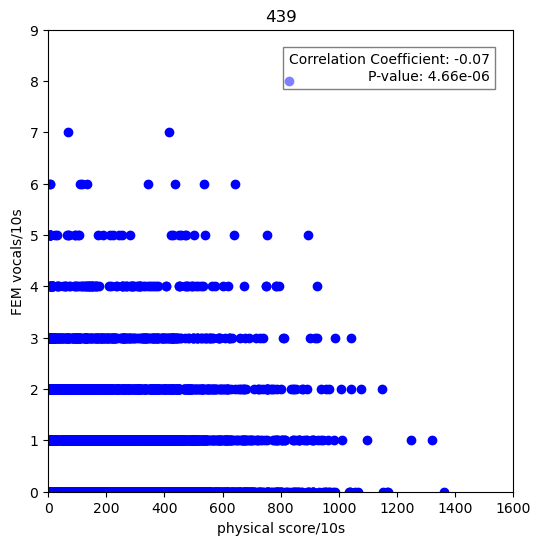

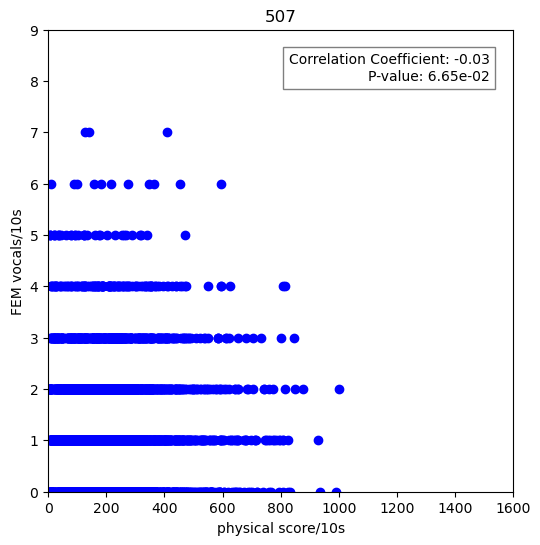

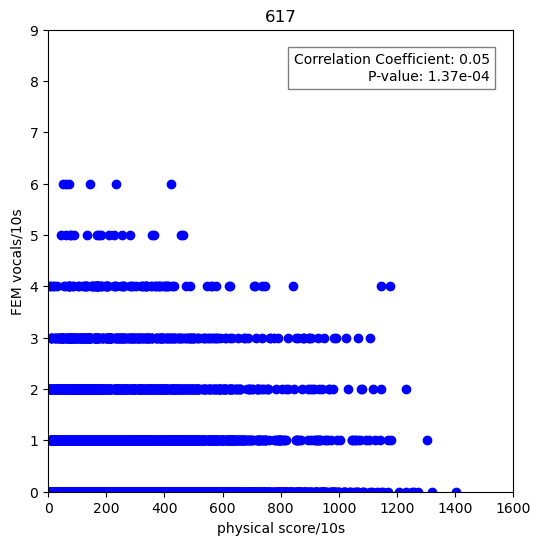

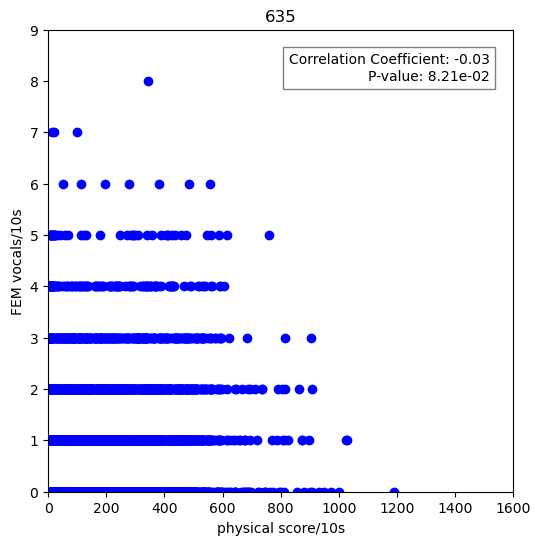

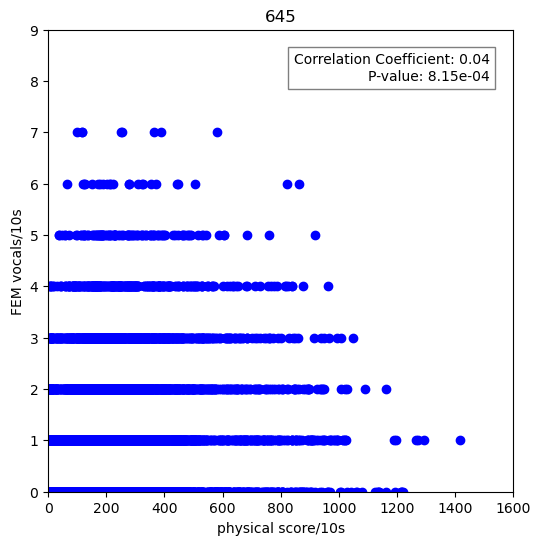

...

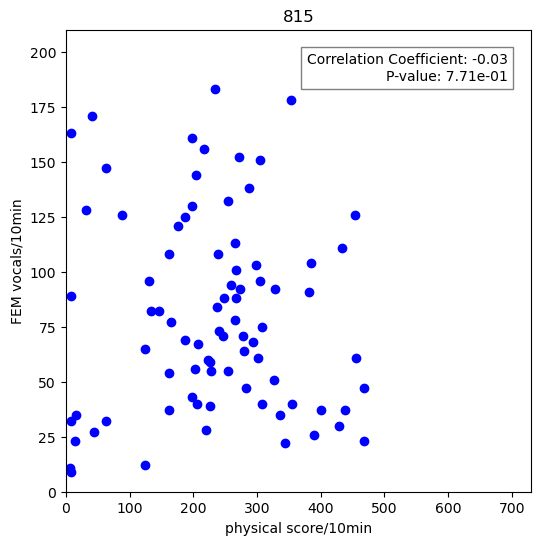

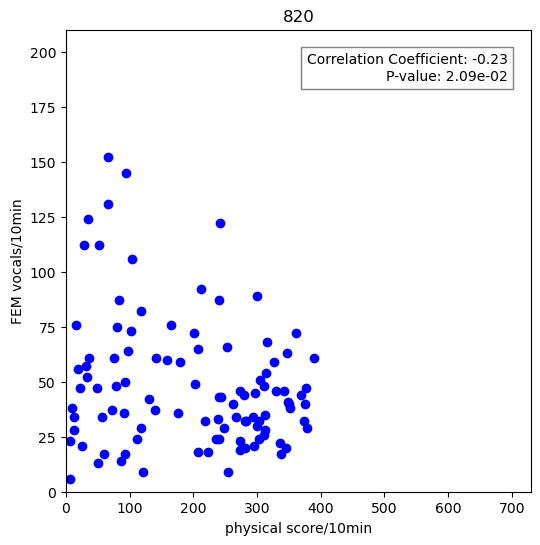

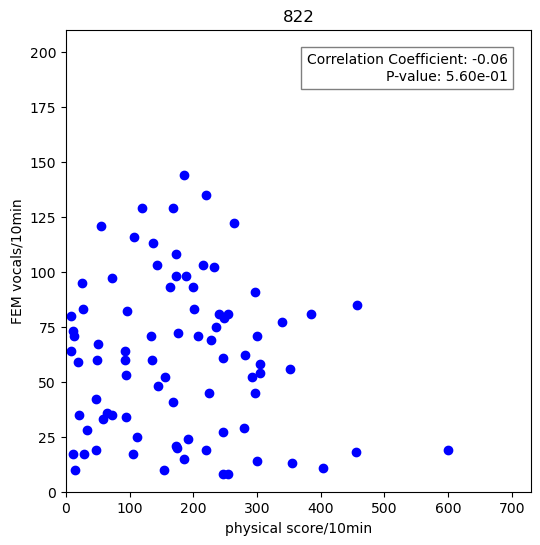

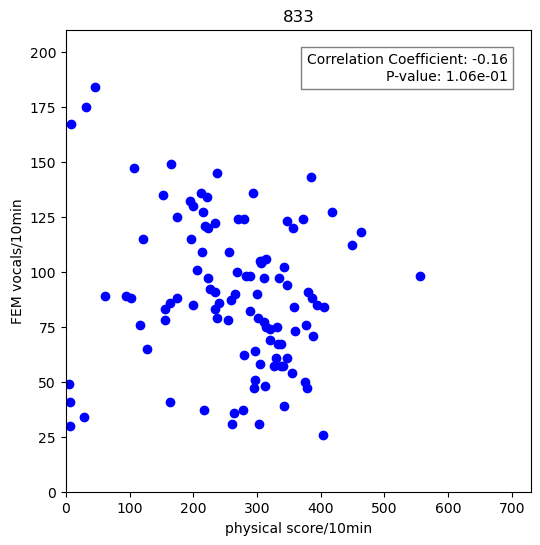

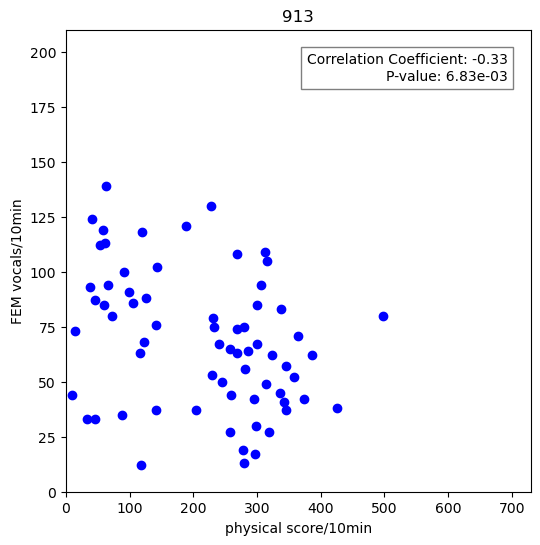

NameError: name 's30m9fos' is not defined

In [73]:
for i in range(len(s10s9os)):
    correlation_coefficient, p_value = pearsonr(s10s9os[i],v10s9fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10s9os[i],v10s9fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,1600)
    plt.ylim(0,9)
    plt.xlabel('physical score/10s')
    plt.ylabel('FEM vocals/10s')
    plt.show()
#1m
for i in range(len(s1m9os)):
    correlation_coefficient, p_value = pearsonr(s1m9os[i],v1m9fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s1m9os[i],v1m9fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,1000)
    plt.ylim(0,35)
    plt.xlabel('physical score/1min')
    plt.ylabel('FEM vocals/1min')
    plt.show()
#10m
for i in range(len(s1m9os)):
    correlation_coefficient, p_value = pearsonr(s10m9os[i],v10m9fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10m9os[i],v10m9fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,730)
    plt.ylim(0,210)
    plt.xlabel('physical score/10min')
    plt.ylabel('FEM vocals/10min')
    plt.show()
#30m
for i in range(len(s30m9fos)):
    correlation_coefficient, p_value = pearsonr(s30m9os[i],v30m9fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s30m9os[i],v30m9fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker9[i])
    plt.xlim(0,530)
    plt.ylim(0,630)
    plt.xlabel('physical score/30min')
    plt.ylabel('FEM vocals/30min')
    plt.show()

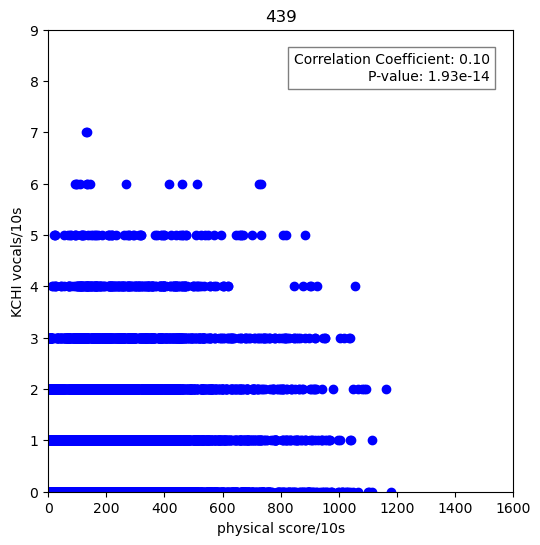

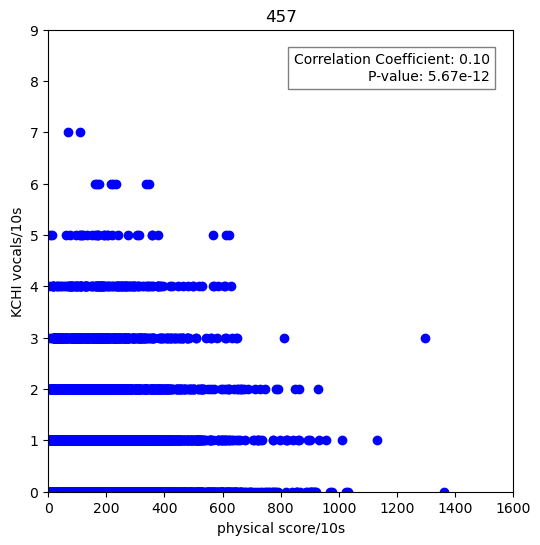

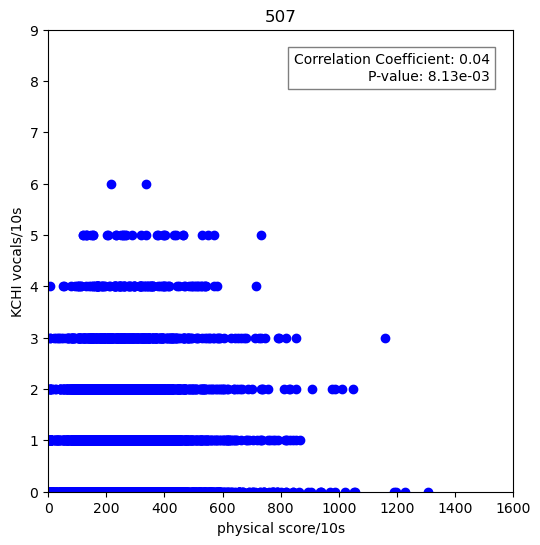

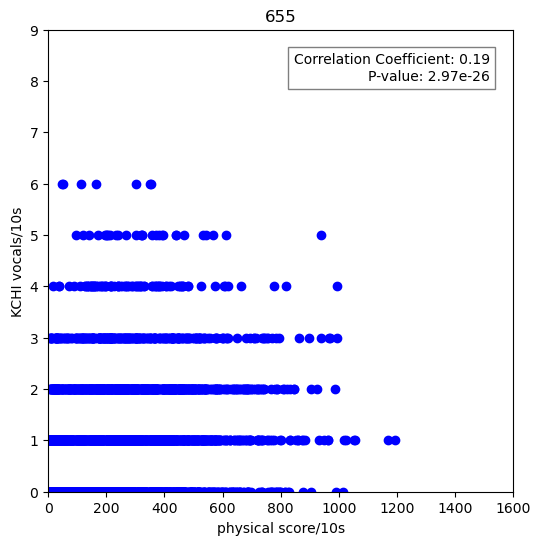

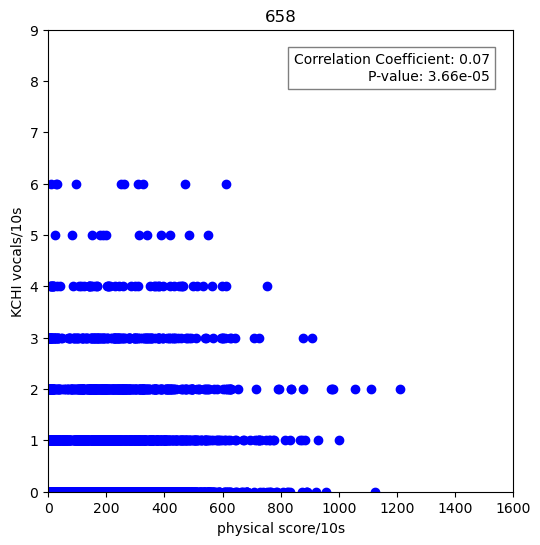

...

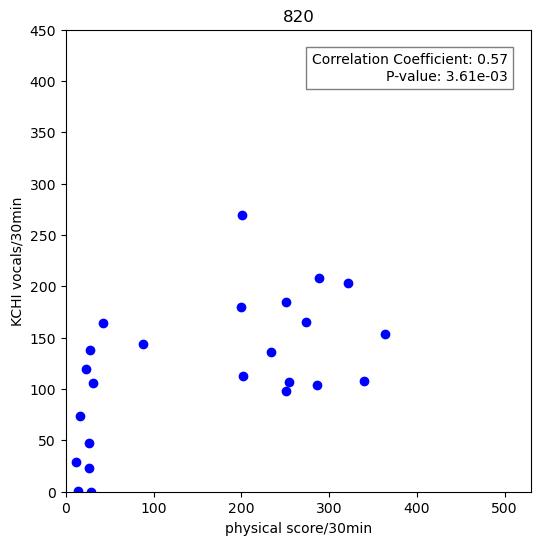

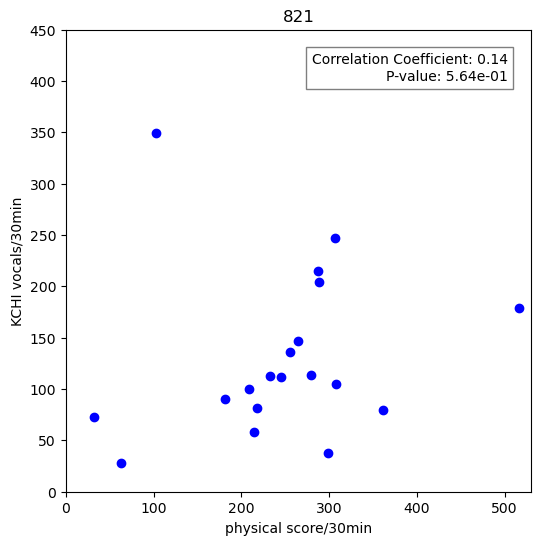

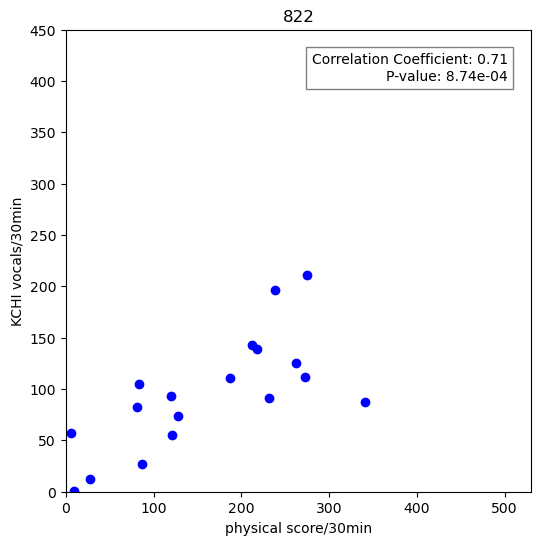

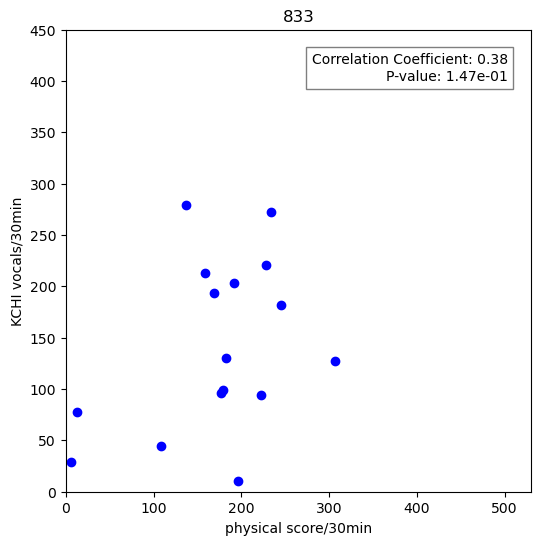

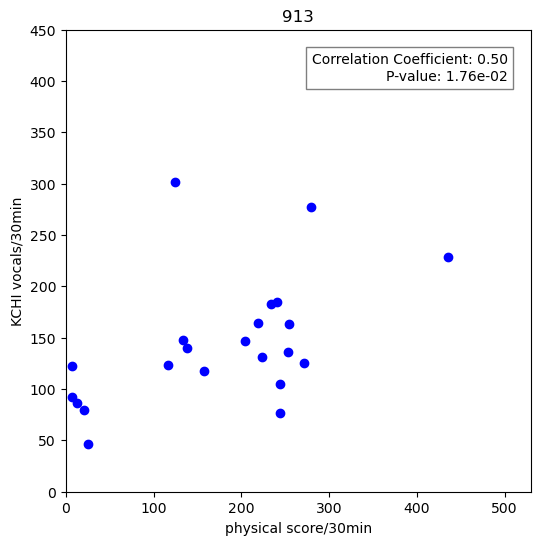

In [74]:
#10s
for i in range(len(s10s12os)):
    correlation_coefficient, p_value = pearsonr(s10s12os[i],v10s12os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10s12os[i],v10s12os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,1600)
    plt.ylim(0,9)
    plt.xlabel('physical score/10s')
    plt.ylabel('KCHI vocals/10s')
    plt.show()
    
#1m
for i in range(len(s1m12os)):
    correlation_coefficient, p_value = pearsonr(s1m12os[i],v1m12os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s1m12os[i],v1m12os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,1000)
    plt.ylim(0,30)
    plt.xlabel('physical score/1min')
    plt.ylabel('KCHI vocals/1min')
    plt.show()
    
#10m
for i in range(len(s10m12os)):
    correlation_coefficient, p_value = pearsonr(s10m12os[i],v10m12os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10m12os[i],v10m12os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,730)
    plt.ylim(0,200)
    plt.xlabel('physical score/10min')
    plt.ylabel('KCHI vocals/10min')
    plt.show()

#30m
for i in range(len(s30m12os)):
    correlation_coefficient, p_value = pearsonr(s30m12os[i],v30m12os[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s30m12os[i],v30m12os[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,530)
    plt.ylim(0,450)
    plt.xlabel('physical score/30min')
    plt.ylabel('KCHI vocals/30min')
    plt.show()

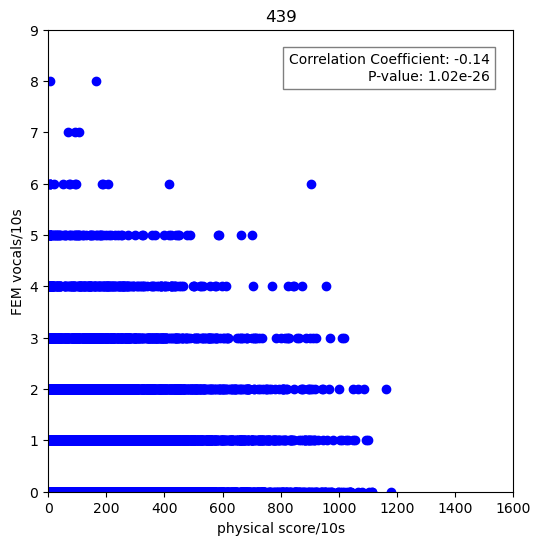

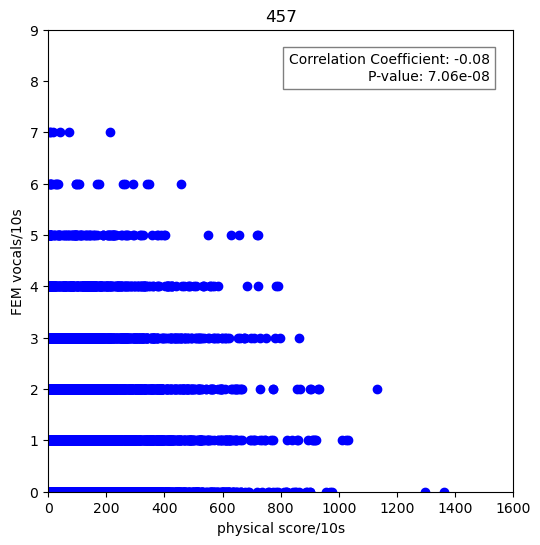

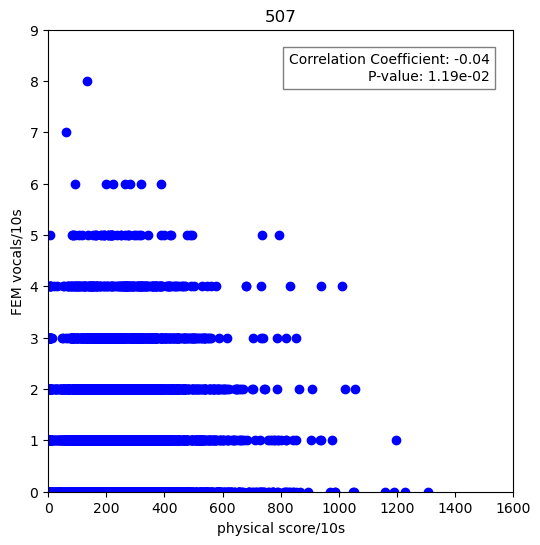

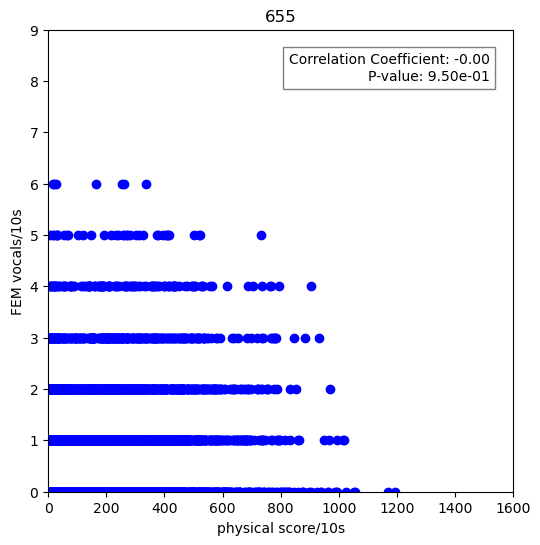

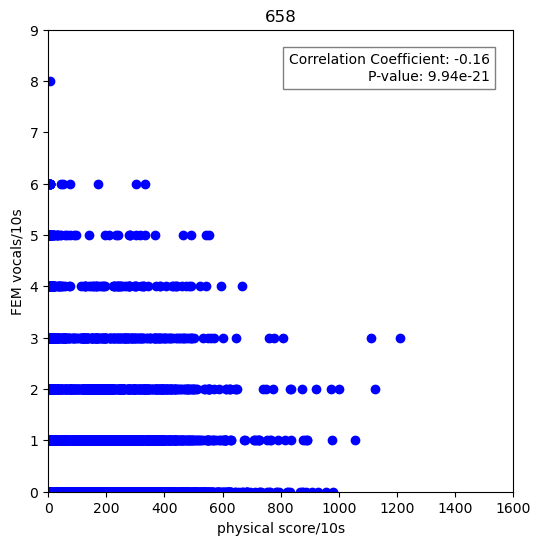

...

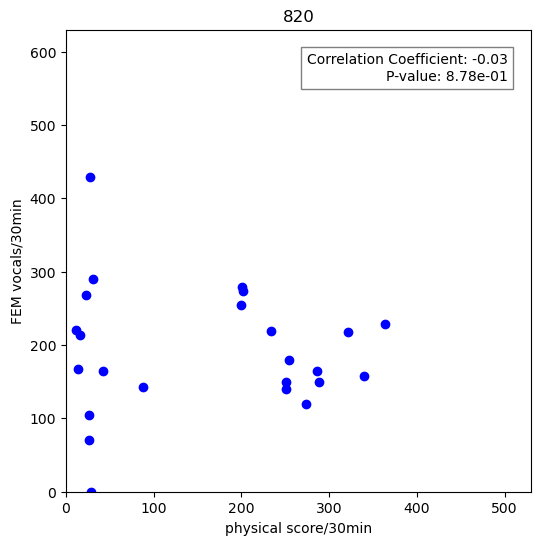

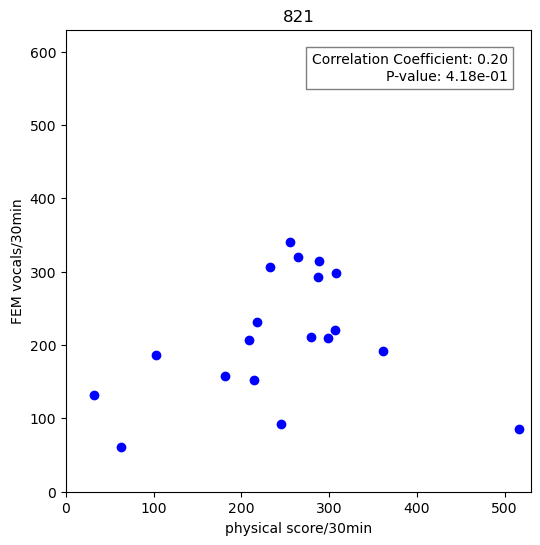

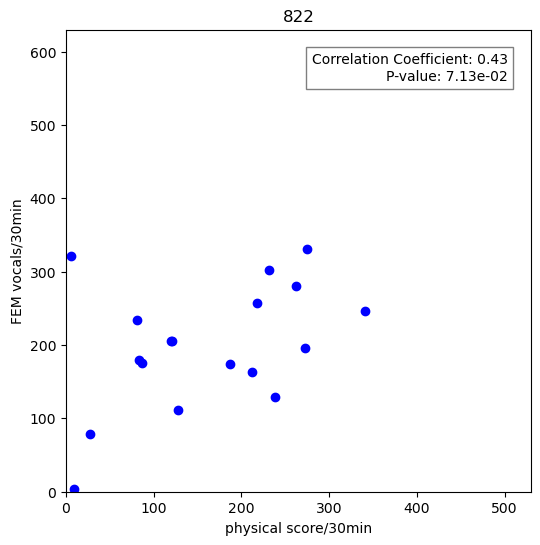

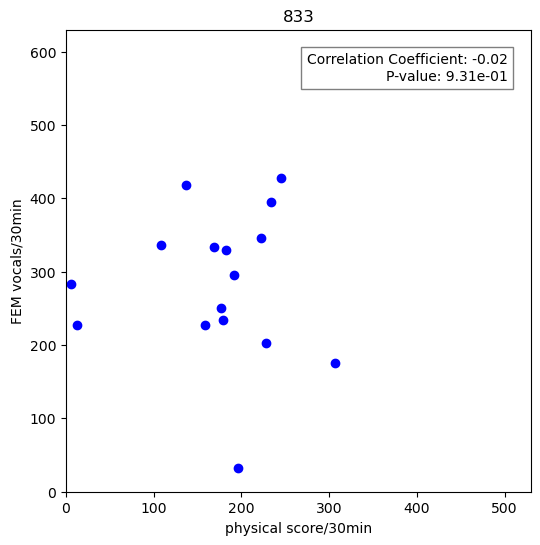

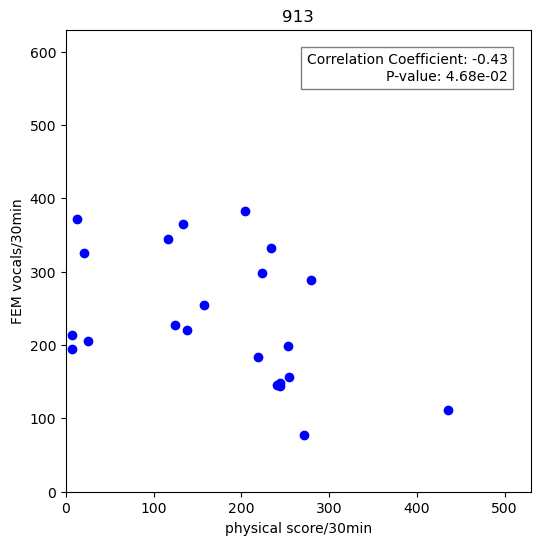

In [75]:
for i in range(len(s10s12os)):
    correlation_coefficient, p_value = pearsonr(s10s12os[i],v10s12fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10s12os[i],v10s12fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,1600)
    plt.ylim(0,9)
    plt.xlabel('physical score/10s')
    plt.ylabel('FEM vocals/10s')
    plt.show()
#1m
for i in range(len(s1m12os)):
    correlation_coefficient, p_value = pearsonr(s1m12os[i],v1m12fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s1m12os[i],v1m12fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,1000)
    plt.ylim(0,35)
    plt.xlabel('physical score/1min')
    plt.ylabel('FEM vocals/1min')
    plt.show()
#10m
for i in range(len(s1m12os)):
    correlation_coefficient, p_value = pearsonr(s10m12os[i],v10m12fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s10m12os[i],v10m12fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,730)
    plt.ylim(0,210)
    plt.xlabel('physical score/10min')
    plt.ylabel('FEM vocals/10min')
    plt.show()
#30m
for i in range(len(s30m12os)):
    correlation_coefficient, p_value = pearsonr(s30m12os[i],v30m12fos[i])
    plt.figure(figsize=(6, 6))
    plt.scatter(s30m12os[i],v30m12fos[i], color='b')
    textstr = f'Correlation Coefficient: {correlation_coefficient:.2f}\nP-value: {p_value:.2e}'
    plt.text(0.95, 0.95, textstr, 
         horizontalalignment='right', 
         verticalalignment='top', 
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.5))

    plt.title(folder_speaker12[i])
    plt.xlim(0,530)
    plt.ylim(0,630)
    plt.xlabel('physical score/30min')
    plt.ylabel('FEM vocals/30min')
    plt.show()

In [76]:
def allc(vin,vfin,sin):
    allv=np.zeros((len(vin)))
    allvf=np.zeros((len(vfin)))
    alls=np.zeros((len(sin)))
    for i in range(len(allv)):
        allv[i]=np.sum(np.array(vin[i]))/len(vin[i])
        allvf[i]=np.sum(np.array(vfin[i]))/len(vfin[i])
        alls[i]=np.sum(np.array(sin[i]))/len(sin[i])
    return allv,allvf,alls

In [77]:
vall6,vallf6,sall6=allc(v1m6os,v1m6fos,s1m6os)
vall9,vallf9,sall9=allc(v1m9os,v1m9fos,s1m9os)
vall12,vallf12,sall12=allc(v1m12os,v1m12fos,s1m12os)

In [78]:
from scipy.stats import pearsonr
cca, cpa = pearsonr(sall6,vall6)
ccaf, cpaf = pearsonr(sall6,vallf6)
print('cca=',cca,'cpa=',cpa)
print('ccaf=',ccaf,'cpaf=',cpaf)

cca= 0.148042336958629 cpa= 0.4704560989056015
ccaf= -0.11152097712358994 cpaf= 0.587558379180483


In [79]:
cca, cpa = pearsonr(sall9,vall9)
ccaf, cpaf = pearsonr(sall9,vallf9)
print('cca=',cca,'cpa=',cpa)
print('ccaf=',ccaf,'cpaf=',cpaf)

cca= 0.299920595246241 cpa= 0.14522476393305747
ccaf= 0.2398983509484661 cpaf= 0.24807118818659976


In [80]:
cca, cpa = pearsonr(sall12,vall12)
ccaf, cpaf = pearsonr(sall12,vallf12)
print('cca=',cca,'cpa=',cpa)
print('ccaf=',ccaf,'cpaf=',cpaf)

cca= 0.03487148314688531 cpa= 0.8775619359035813
ccaf= -0.2975852614649534 cpaf= 0.17861475475339977


In [81]:
print(len(matchidall),len(matchidall69),len(matchidall912),len(matchidall612))

7 14 13 16


In [82]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']

In [83]:
allid=np.array(matchidall).reshape(len(matchidall),3)

In [84]:
allid[:,2]

array([ 0,  2,  4,  9, 17, 20, 21])

In [85]:
allv6=vall6[allid[:,0]]
allv9=vall9[allid[:,1]]
allv12=vall12[allid[:,2]]

In [86]:
alls6=sall6[allid[:,0]]
alls9=sall9[allid[:,1]]
alls12=sall12[allid[:,2]]

In [87]:
allvf6=vallf6[allid[:,0]]
allvf9=vallf9[allid[:,1]]
allvf12=vallf12[allid[:,2]]

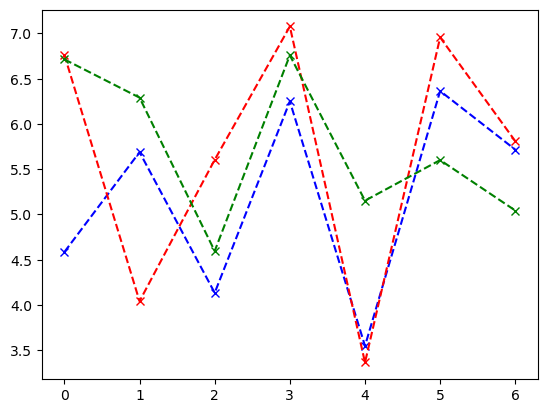

In [88]:
plt.plot(allv6,'--x',c='blue')
plt.plot(allv9,'--x',c='red')
plt.plot(allv12,'--x',c='green')

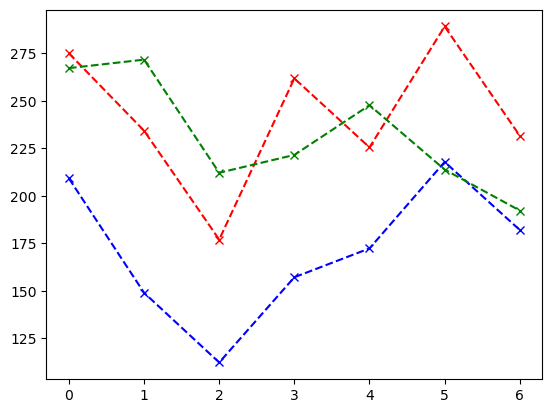

In [89]:
plt.plot(alls6,'--x',c='blue')
plt.plot(alls9,'--x',c='red')
plt.plot(alls12,'--x',c='green')

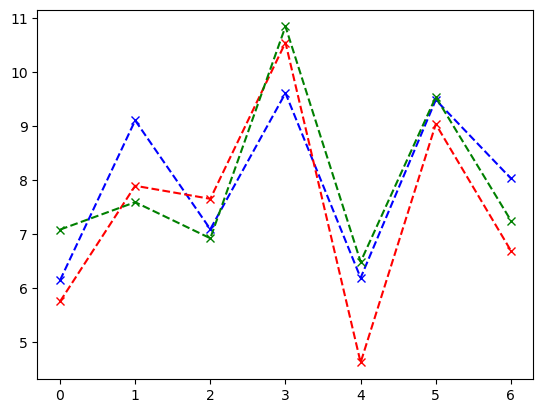

In [90]:
plt.plot(allvf6,'--x',c='blue')
plt.plot(allvf9,'--x',c='red')
plt.plot(allvf12,'--x',c='green')

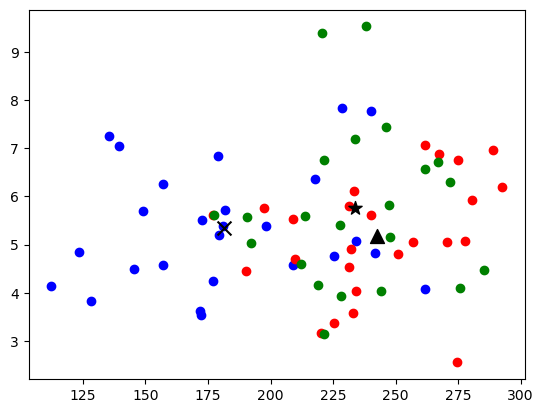

In [91]:
plt.scatter(sall6,vall6,color='blue')
plt.scatter(np.mean(sall6),np.mean(vall6),marker='x',s=100,color='black')
plt.scatter(sall9,vall9,color='red')
plt.scatter(np.mean(sall9),np.mean(vall9),marker='^',s=100,color='black')
plt.scatter(sall12,vall12,color='green')
plt.scatter(np.mean(sall12),np.mean(vall12),marker='*',s=100,color='black')
plt.show()

{(0, 1): 2.8938410287903646e-07, (0, 2): 6.945279474297991e-06, (1, 2): 0.3329885913256705}


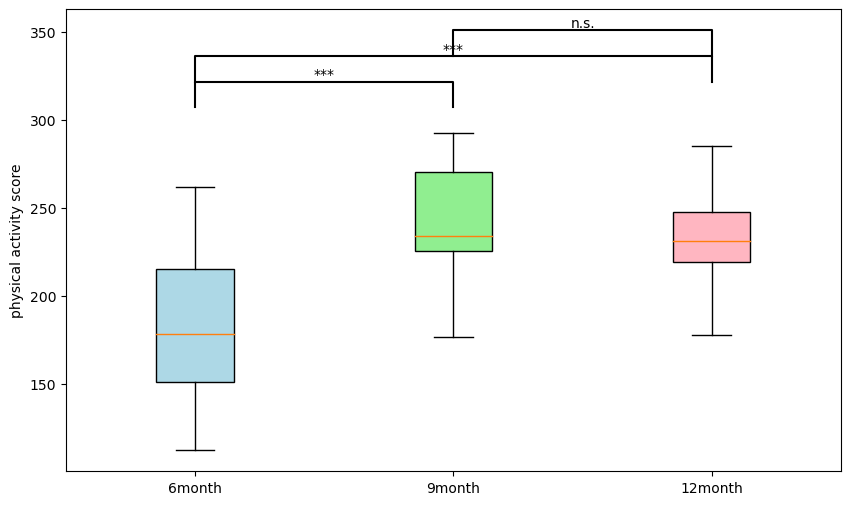

In [92]:
from scipy.stats import ttest_ind
plots=[sall6,sall9,sall12]
p_values = {}
pairs = [(0, 1), (0, 2), (1, 2)]
for (i, j) in pairs:
    t_stat, p_val = ttest_ind(plots[i], plots[j])
    p_values[(i, j)] = p_val
print(p_values)
plt.figure(figsize=(10, 6))
box=plt.boxplot(plots, patch_artist=True)
colors = ['lightblue', 'lightgreen', 'lightpink']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
# Set the labels for the x-axis
plt.xticks([1, 2, 3], ['6month', '9month', '12month'])
plt.ylabel('physical activity score')

# Function to add significance stars
def add_significance_star(x1, x2, y, p_val, h):
    """Add significance stars between two box plots."""
    if p_val < 0.001:
        text = '***'
    elif p_val < 0.01:
        text = '**'
    elif p_val < 0.05:
        text = '*'
    else:
        text = 'n.s.'  # not significant

    plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, color='black')
    plt.text((x1 + x2) * 0.5, y + h, text, ha='center', va='bottom', color='black')

# Add significance stars to the plot
y_max = max(max(sall6), max(sall9), max(sall12))
h = y_max * 0.05
for (i, j) in pairs:
    y = y_max + (pairs.index((i, j)) + 1) * h
    add_significance_star(i + 1, j + 1, y, p_values[(i, j)], h)
plt.show()

{(0, 1): 0.6494258701212585, (0, 2): 0.33162675592117274, (1, 2): 0.1827006242366391}


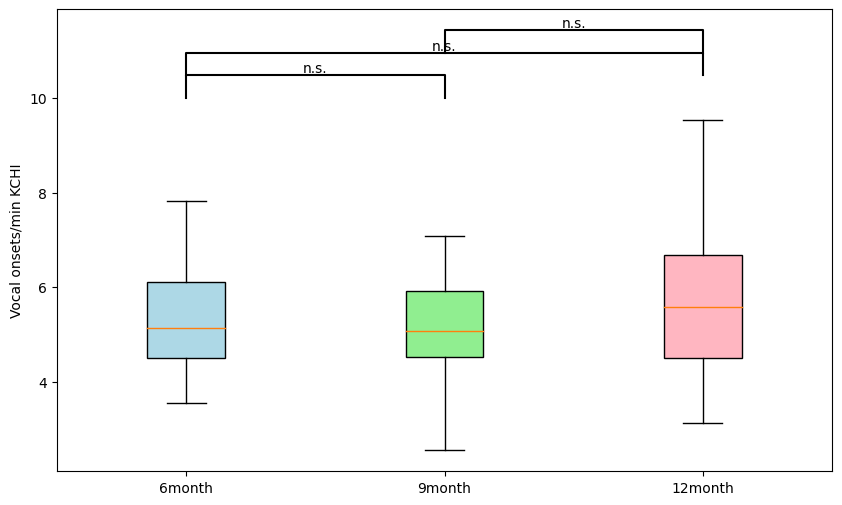

In [93]:
from scipy.stats import ttest_ind
plotv=[vall6,vall9,vall12]
p_values = {}
pairs = [(0, 1), (0, 2), (1, 2)]
for (i, j) in pairs:
    t_stat, p_val = ttest_ind(plotv[i], plotv[j])
    p_values[(i, j)] = p_val
print(p_values)
plt.figure(figsize=(10, 6))
box=plt.boxplot(plotv, patch_artist=True)
colors = ['lightblue', 'lightgreen', 'lightpink']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
# Set the labels for the x-axis
plt.xticks([1, 2, 3], ['6month', '9month', '12month'])
plt.ylabel('Vocal onsets/min KCHI')

# Function to add significance stars
def add_significance_star(x1, x2, y, p_val, h):
    """Add significance stars between two box plots."""
    if p_val < 0.001:
        text = '***'
    elif p_val < 0.01:
        text = '**'
    elif p_val < 0.05:
        text = '*'
    else:
        text = 'n.s.'  # not significant

    plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, color='black')
    plt.text((x1 + x2) * 0.5, y + h, text, ha='center', va='bottom', color='black')

# Add significance stars to the plot
y_max = max(max(vall6), max(vall9), max(vall12))
h = y_max * 0.05
for (i, j) in pairs:
    y = y_max + (pairs.index((i, j)) + 1) * h
    add_significance_star(i + 1, j + 1, y, p_values[(i, j)], h)
plt.show()

{(0, 1): 0.045486916386354444, (0, 2): 0.4333507698702239, (1, 2): 0.2601621926238382}


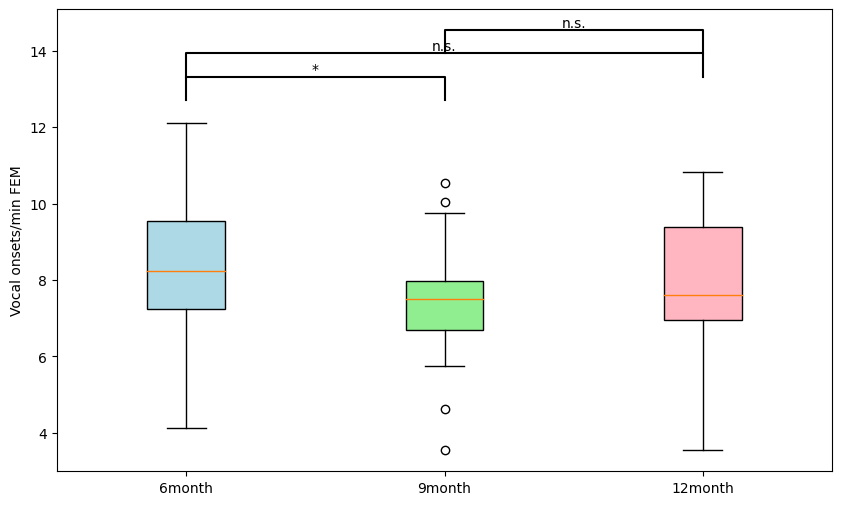

In [94]:
from scipy.stats import ttest_ind
plotvf=[vallf6,vallf9,vallf12]
p_values = {}
pairs = [(0, 1), (0, 2), (1, 2)]
for (i, j) in pairs:
    t_stat, p_val = ttest_ind(plotvf[i], plotvf[j])
    p_values[(i, j)] = p_val
print(p_values)
plt.figure(figsize=(10, 6))
box=plt.boxplot(plotvf, patch_artist=True)
colors = ['lightblue', 'lightgreen', 'lightpink']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
# Set the labels for the x-axis
plt.xticks([1, 2, 3], ['6month', '9month', '12month'])
plt.ylabel('Vocal onsets/min FEM')

# Function to add significance stars
def add_significance_star(x1, x2, y, p_val, h):
    """Add significance stars between two box plots."""
    if p_val < 0.001:
        text = '***'
    elif p_val < 0.01:
        text = '**'
    elif p_val < 0.05:
        text = '*'
    else:
        text = 'n.s.'  # not significant

    plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, color='black')
    plt.text((x1 + x2) * 0.5, y + h, text, ha='center', va='bottom', color='black')

# Add significance stars to the plot
y_max = max(max(vallf6), max(vallf9), max(vallf12))
h = y_max * 0.05
for (i, j) in pairs:
    y = y_max + (pairs.index((i, j)) + 1) * h
    add_significance_star(i + 1, j + 1, y, p_values[(i, j)], h)
plt.show()

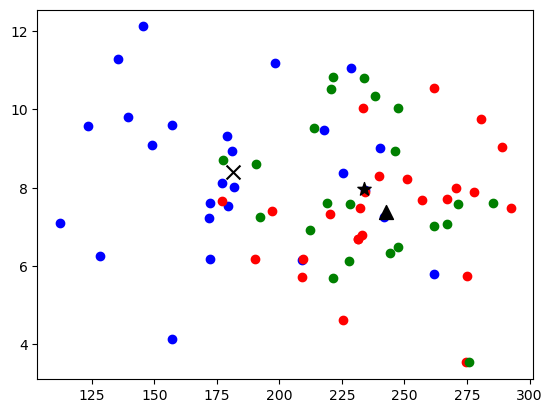

In [95]:
plt.scatter(sall6,vallf6,color='blue')
plt.scatter(np.mean(sall6),np.mean(vallf6),marker='x',s=100,color='black')
plt.scatter(sall9,vallf9,color='red')
plt.scatter(np.mean(sall9),np.mean(vallf9),marker='^',s=100,color='black')
plt.scatter(sall12,vallf12,color='green')
plt.scatter(np.mean(sall12),np.mean(vallf12),marker='*',s=100,color='black')
plt.show()

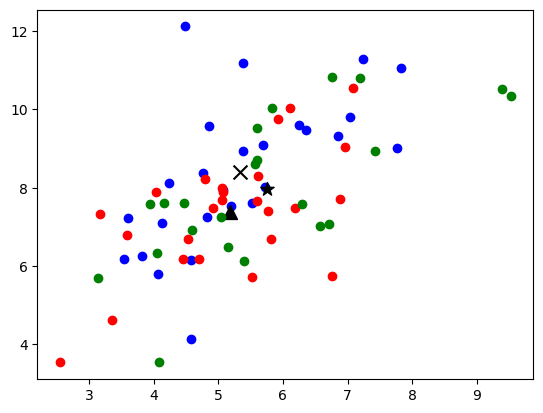

In [96]:
plt.scatter(vall6,vallf6,color='blue')
plt.scatter(np.mean(vall6),np.mean(vallf6),marker='x',s=100,color='black')
plt.scatter(vall9,vallf9,color='red')
plt.scatter(np.mean(vall9),np.mean(vallf9),marker='^',s=100,color='black')
plt.scatter(vall12,vallf12,color='green')
plt.scatter(np.mean(vall12),np.mean(vallf12),marker='*',s=100,color='black')
plt.show()

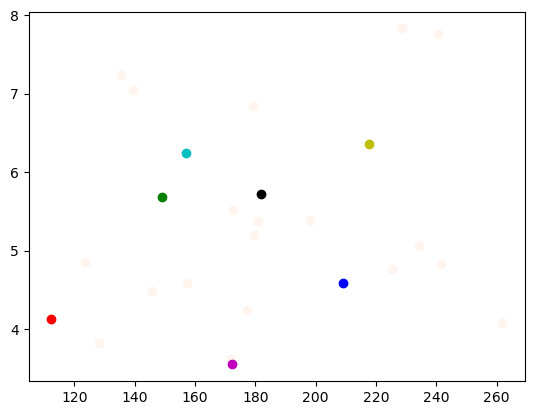

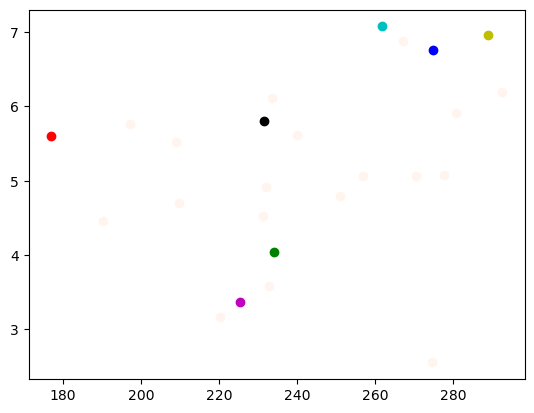

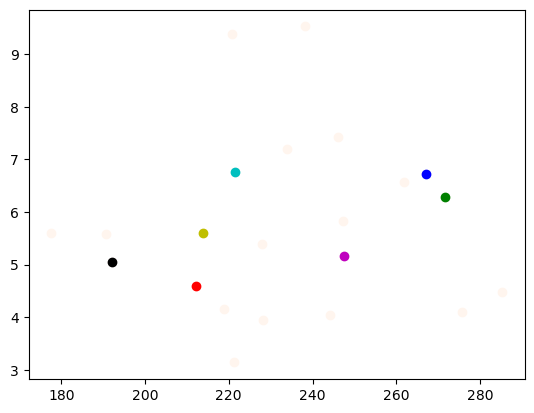

In [98]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']
plt.scatter(sall6,vall6,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(sall6[id6],vall6[id6],c=color[i])
plt.show()
plt.scatter(sall9,vall9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(sall9[id9],vall9[id9],c=color[i])
plt.show()
plt.scatter(sall12,vall12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(sall12[id12],vall12[id12],c=color[i])
plt.show()

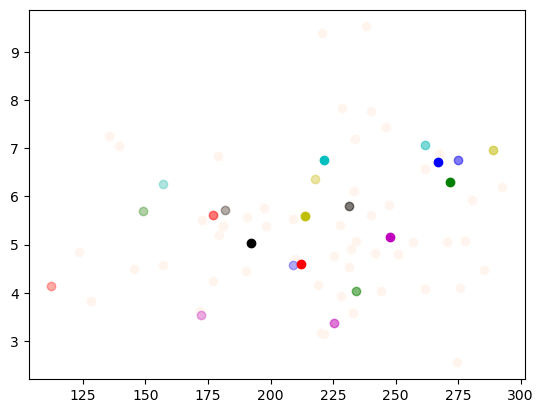

In [99]:
plt.scatter(sall6,vall6,color='seashell')
plt.scatter(sall9,vall9,color='seashell')
plt.scatter(sall12,vall12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(sall6[id6],vall6[id6],c=color[i], alpha=0.3)
#plt.show()

for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(sall9[id9],vall9[id9],c=color[i],alpha=0.5)
#plt.show()

for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(sall12[id12],vall12[id12],c=color[i])
plt.show()

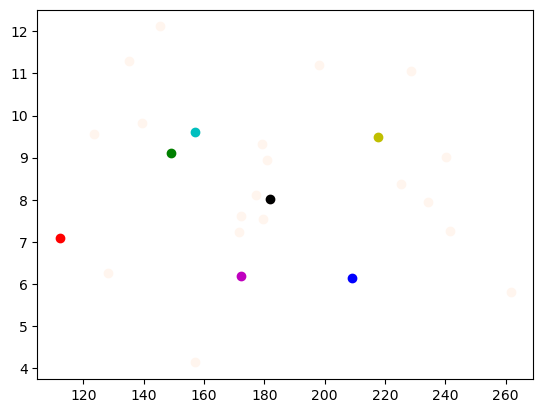

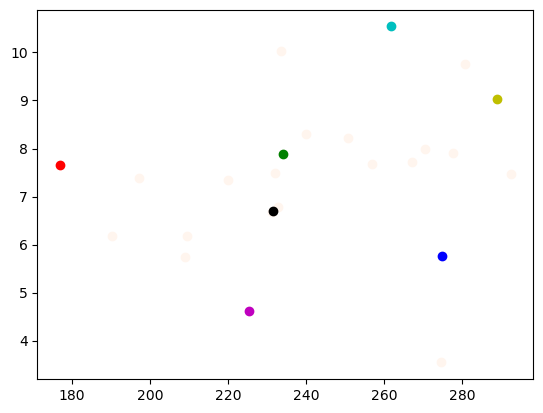

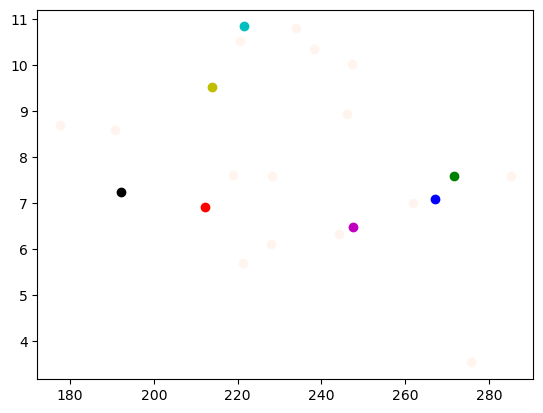

In [100]:
plt.scatter(sall6,vallf6,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(sall6[id6],vallf6[id6],c=color[i])
plt.show()
plt.scatter(sall9,vallf9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(sall9[id9],vallf9[id9],c=color[i])
plt.show()
plt.scatter(sall12,vallf12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(sall12[id12],vallf12[id12],c=color[i])
plt.show()

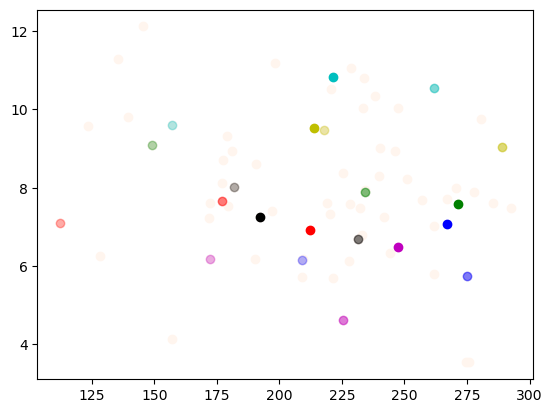

In [101]:
plt.scatter(sall6,vallf6,color='seashell')
plt.scatter(sall9,vallf9,color='seashell')
plt.scatter(sall12,vallf12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(sall6[id6],vallf6[id6],c=color[i], alpha=0.3)
#plt.show()

for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(sall9[id9],vallf9[id9],c=color[i], alpha=0.5)
#plt.show()

for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(sall12[id12],vallf12[id12],c=color[i])
plt.show()

In [102]:
vall9

array([6.76184032, 4.04174573, 2.55373406, 3.58784893, 5.08135942,
       6.19164619, 5.60436893, 5.06376812, 5.61187608, 5.52303861,
       6.88091603, 7.07692308, 4.70458404, 5.06116643, 6.11251758,
       5.91836735, 4.52989691, 4.91816921, 5.76645963, 3.17236256,
       4.8       , 3.3647587 , 4.45859873, 6.95634096, 5.80967742])

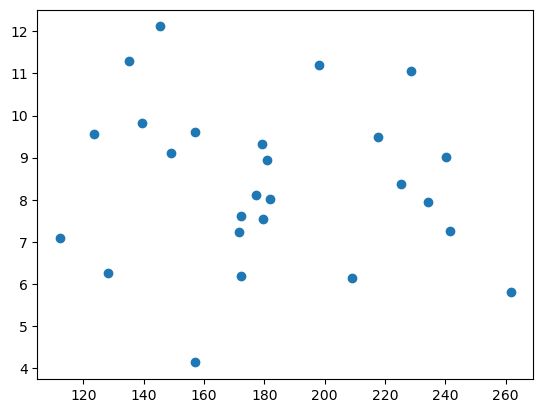

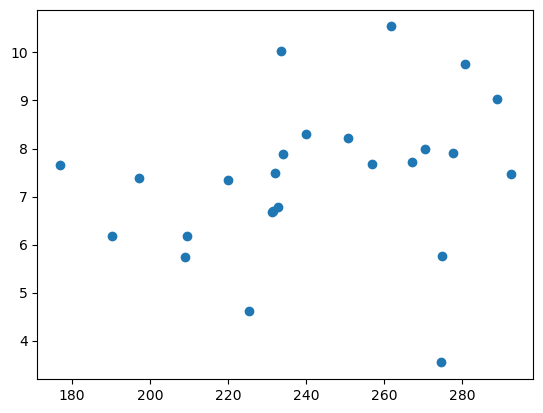

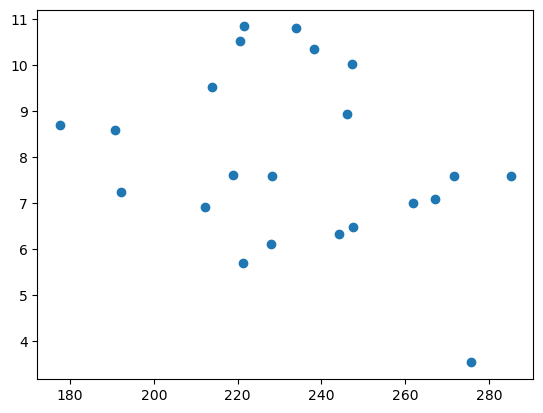

In [103]:
plt.scatter(sall6,vallf6)
plt.show()
plt.scatter(sall9,vallf9)
plt.show()
plt.scatter(sall12,vallf12)
plt.show()

In [104]:

s30m6l=[item for sublist in s30m6os for item in sublist]
v30m6l=[item for sublist in v30m6os for item in sublist]
v30m6fl=[item for sublist in v30m6fos for item in sublist]
cc30m, cp30m = pearsonr(s30m6l,v30m6l)
cc30mf, cp30mf = pearsonr(s30m6l,v30m6fl)
print('c30m=',cc30m,'c30m_p=',cp30m)
print('c30m=',cc30mf,'c30m_p=',cp30mf)

c30m= 0.45740992909040484 c30m_p= 2.343038463009587e-44
c30m= -0.033027115455309994 c30m_p= 0.3407819593246878


In [105]:
s10m6l=[item for sublist in s10m6os for item in sublist]
v10m6l=[item for sublist in v10m6os for item in sublist]
v10m6fl=[item for sublist in v10m6fos for item in sublist]
cc10m, cp10m = pearsonr(s10m6l,v10m6l)
print('c10m=',cc10m,'c10m_p=',cp10m)
cc10mf, cp10mf = pearsonr(s10m6l,v10m6fl)
print('c10m=',cc10mf,'c10m_p=',cp10mf)

c10m= 0.3468627782030222 c10m_p= 1.4247023786246157e-66
c10m= -0.08624423951545133 c10m_p= 3.1882513488409234e-05


In [106]:
s1m6l=[item for sublist in s1m6os for item in sublist]
v1m6l=[item for sublist in v1m6os for item in sublist]
v1m6fl=[item for sublist in v1m6fos for item in sublist]
cc1m, cp1m = pearsonr(s1m6l,v1m6l)
print('c1m=',cc1m,'c1m_p=',cp1m)
cc1mf, cp1mf = pearsonr(s1m6l,v1m6fl)
print('c1m=',cc1mf,'c1m_p=',cp1mf)

c1m= 0.16674104163305248 c1m_p= 6.758998184197615e-132
c1m= -0.05259892652232693 c1m_p= 1.855007926587632e-14


In [107]:
s10s6l=[item for sublist in s10s6os for item in sublist]
v10s6l=[item for sublist in v10s6os for item in sublist]
v10s6fl=[item for sublist in v10s6fos for item in sublist]
cc10s, cp10s = pearsonr(s10s6l,v10s6l)
print('c10s=',cc10s,'c10s_p=',cp10s)
cc10sf, cp10sf = pearsonr(s10s6l,v10s6fl)
print('c10s=',cc10sf,'c10s_p=',cp10sf)

c10s= 0.09145653926252763 c10s_p= 7.052057084979945e-231
c10s= -0.029143169379129537 c10s_p= 5.823454664713083e-25


In [108]:
s1s6l=[item for sublist in s1s6os for item in sublist]
v1s6l=[item for sublist in v1s6os for item in sublist]
v1s6fl=[item for sublist in v1s6fos for item in sublist]
cc1s, cp1s = pearsonr(s1s6l,v1s6l)
print('c1s=',cc1s,'c1s_p=',cp1s)
cc1sf, cp1sf = pearsonr(s1s6l,v1s6fl)
print('c1s=',cc1sf,'c1s_p=',cp1sf)

c1s= 0.03292679293393554 c1s_p= 1.145626574392342e-295
c1s= -0.010889697117615197 c1s_p= 5.644492443170399e-34


In [109]:
s30m9l=[item for sublist in s30m9os for item in sublist]
v30m9l=[item for sublist in v30m9os for item in sublist]
v30m9fl=[item for sublist in v30m9fos for item in sublist]
cc30m, cp30m = pearsonr(s30m9l,v30m9l)
print('c30m=',cc30m,'c30s_p=',cp30m)
cc30mf, cp30mf = pearsonr(s30m9l,v30m9fl)
print('c30mf=',cc30mf,'c30sf_p=',cp30mf)

c30m= 0.43722507521717513 c30s_p= 1.6676881081024055e-36
c30mf= -0.024816519624724094 c30sf_p= 0.4965299908541897


In [110]:
s10m9l=[item for sublist in s10m9os for item in sublist]
v10m9l=[item for sublist in v10m9os for item in sublist]
v10m9fl=[item for sublist in v10m9fos for item in sublist]
cc10m, cp10m = pearsonr(s10m9l,v10m9l)
print('c10m=',cc10m,'c10m_p=',cp10m)
cc10mf, cp10mf = pearsonr(s10m9l,v10m9fl)
print('c10mf=',cc10mf,'c10mf_p=',cp10mf)

c10m= 0.3168568477331086 c10m_p= 8.962743212610255e-50
c10mf= -0.05217300077858142 c10mf_p= 0.01727553593552314


In [111]:
s1m9l=[item for sublist in s1m9os for item in sublist]
v1m9l=[item for sublist in v1m9os for item in sublist]
v1m9fl=[item for sublist in v1m9fos for item in sublist]
cc1m, cp1m = pearsonr(s1m9l,v1m9l)
print('c1m=',cc1m,'c1m_p=',cp1m)
cc1mf, cp1mf = pearsonr(s1m9l,v1m9fl)
print('c1mf=',cc1mf,'c1mf_p=',cp1mf)

c1m= 0.1463460326494367 c1m_p= 9.187992949066514e-93
c1mf= -0.026505021891953483 c1mf_p= 0.000232599180132473


In [112]:
s10s9l=[item for sublist in s10s9os for item in sublist]
v10s9l=[item for sublist in v10s9os for item in sublist]
v10s9fl=[item for sublist in v10s9fos for item in sublist]
cc10s, cp10s = pearsonr(s10s9l,v10s9l)
print('c10s=',cc10s,'c10s_p=',cp10s)
cc10sf, cp10sf = pearsonr(s10s9l,v10s9fl)
print('c10sf=',cc10sf,'c10sf_p=',cp10sf)

c10s= 0.08007289602750403 c10s_p= 3.0356001430861267e-162
c10sf= -0.01656831101010089 c10sf_p= 2.0499002769386533e-08


In [113]:
s1s9l=[item for sublist in s1s9os for item in sublist]
v1s9l=[item for sublist in v1s9os for item in sublist]
v1s9fl=[item for sublist in v1s9fos for item in sublist]
cc1s, cp1s = pearsonr(s1s9l,v1s9l)
print('c1s=',cc1s,'c1s_p=',cp1s)
cc1sf, cp1sf = pearsonr(s1s9l,v1s9fl)
print('c1sf=',cc1sf,'c1sf_p=',cp1sf)

c1s= 0.029071376918661282 c1s_p= 3.956229432276557e-212
c1sf= -0.005504481683931593 c1sf_p= 3.995724531945499e-09


In [114]:
s30m12l=[item for sublist in s30m12os for item in sublist]
v30m12l=[item for sublist in v30m12os for item in sublist]
v30m12fl=[item for sublist in v30m12fos for item in sublist]
cc30m, cp30m = pearsonr(s30m12l,v30m12l)
print('c30m=',cc30m,'c30s_p=',cp30m)
cc30mf, cp30mf = pearsonr(s30m12l,v30m12fl)
print('c30mf=',cc30mf,'c30m_p=',cp30mf)

c30m= 0.4559403569190436 c30s_p= 2.0707139540910543e-33
c30mf= -0.12117663505662317 c30m_p= 0.0024090226860649555


In [115]:
s10m12l=[item for sublist in s10m12os for item in sublist]
v10m12l=[item for sublist in v10m12os for item in sublist]
v10m12fl=[item for sublist in v10m12fos for item in sublist]
cc10m, cp10m = pearsonr(s10m12l,v10m12l)
print('c10m=',cc10m,'c10m_p=',cp10m)
cc10mf, cp10mf = pearsonr(s10m12l,v10m12fl)
print('c10mf=',cc10mf,'c10m_p=',cp10mf)

c10m= 0.3578672242584588 c10m_p= 6.700918444438226e-54
c10mf= -0.10587753050635224 c10m_p= 9.275516224969842e-06


In [116]:
s1m12l=[item for sublist in s1m12os for item in sublist]
v1m12l=[item for sublist in v1m12os for item in sublist]
v1m12fl=[item for sublist in v1m12fos for item in sublist]
cc1m, cp1m = pearsonr(s1m12l,v1m12l)
print('c1m=',cc1m,'c1s_p=',cp1m)
cc1mf, cp1mf = pearsonr(s1m12l,v1m12fl)
print('c1mf=',cc1mf,'c30s_p=',cp1mf)

c1m= 0.17445572525397487 c1s_p= 2.119029441108988e-110
c1mf= -0.08888143720995192 c30s_p= 1.1829029658498466e-29


In [117]:
s10s12l=[item for sublist in s10s12os for item in sublist]
v10s12l=[item for sublist in v10s12os for item in sublist]
v10s12fl=[item for sublist in v10s12fos for item in sublist]
cc10s, cp10s = pearsonr(s10s12l,v10s12l)
print('c10s=',cc10s,'c10s_p=',cp10s)
cc10sf, cp10sf = pearsonr(s10s12l,v10s12fl)
print('c10sf=',cc10mf,'c10s_p=',cp10sf)

c10s= 0.09320452763026243 c10s_p= 1.3268696889899395e-183
c10sf= -0.10587753050635224 c10s_p= 5.193333901953328e-64


In [118]:
s1s12l=[item for sublist in s1s12os for item in sublist]
v1s12l=[item for sublist in v1s12os for item in sublist]
v1s12fl=[item for sublist in v1s12fos for item in sublist]
cc1s, cp1s = pearsonr(s1s12l,v1s12l)
print('c1s=',cc1s,'c1s_p=',cp1s)
cc1sf, cp1sf = pearsonr(s1s12l,v1s12fl)
print('c1sf=',cc1mf,'c1s_p=',cp1sf)

c1s= 0.03199769123748424 c1s_p= 1.8046979852956436e-214
c1sf= -0.08888143720995192 c1s_p= 1.6330098900070258e-72


In [119]:
print('s10s6=',np.max(s10s6l))
print('s1m6=',np.max(s1m6l))
print('s10m6=',np.max(s10m6l))
print('s30m6=',np.max(s30m6l))

print('v10s6=',np.max(v10s6l),np.mean(v10s6l))
print('v1m6=',np.max(v1m6l))
print('v10m6=',np.max(v10m6l))
print('v30m6=',np.max(v30m6l))

print('vf10s6=',np.max(v10s6fl))
print('vf1m6=',np.max(v1m6fl))
print('vf10m6=',np.max(v10m6fl),np.mean(v10m6fl))
print('vf30m6=',np.max(v30m6fl))

s10s6= 1532.8965908479522
s1m6= 974.5319893482126
s10m6= 721.3497653045811
s30m6= 440.29208874825804
v10s6= 8.0 0.9122141973584454
v1m6= 27.0
v10m6= 196.0
v30m6= 470.0
vf10s6= 9.0
vf1m6= 32.0
vf10m6= 209.0 83.58318965517242
vf30m6= 558.0


In [120]:
print('s10s9=',np.max(s10s9l))
print('s1m9=',np.max(s1m9l))
print('s10m9=',np.max(s10m9l))
print('s30m9=',np.max(s30m9l))

print('v10s9=',np.max(v10s9l),np.mean(v10s9l))
print('v1m9=',np.max(v1m9l))
print('v10m9=',np.max(v10m9l))
print('v30m9=',np.max(v30m9l))

print('vf10s9=',np.max(v10s9fl))
print('vf1m9=',np.max(v1m9fl))
print('vf10m9=',np.max(v10m9fl),np.mean(v10m9fl))
print('vf30m9=',np.max(v30m9fl))

s10s9= 1417.1235534561665
s1m9= 975.3215138857179
s10m9= 640.4148991856689
s30m9= 530.3880298323938
v10s9= 9.0 0.8601311297940512
v1m9= 27.0
v10m9= 164.0
v30m9= 447.0
vf10s9= 9.0
vf1m9= 33.0
vf10m9= 209.0 73.35638808837656
vf30m9= 631.0


In [121]:
print('s10s12=',np.max(s10s12l))
print('s1m12=',np.max(s1m12l))
print('s10m12=',np.max(s10m12l))
print('s30m12=',np.max(s30m12l))

print('v10s12=',np.max(v10s12l),np.mean(v10s12l))
print('v1m12=',np.max(v1m12l))
print('v10m12=',np.max(v10m12l))
print('v30m12=',np.max(v30m12l))

print('vf10s12=',np.max(v10s12fl))
print('vf1m12=',np.max(v1m12fl))
print('vf10m12=',np.max(v10m12fl),np.mean(v10m12fl))
print('vf30m12=',np.max(v30m12fl))

s10s12= 1363.3616235236057
s1m12= 991.4604145235996
s10m12= 640.8586851095354
s30m12= 516.14272720188
v10s12= 8.0 0.9838669230126222
v1m12= 29.0
v10m12= 188.0
v30m12= 407.0
vf10s12= 8.0
vf1m12= 31.0
vf10m12= 196.0 79.05211912943872
vf30m12= 542.0


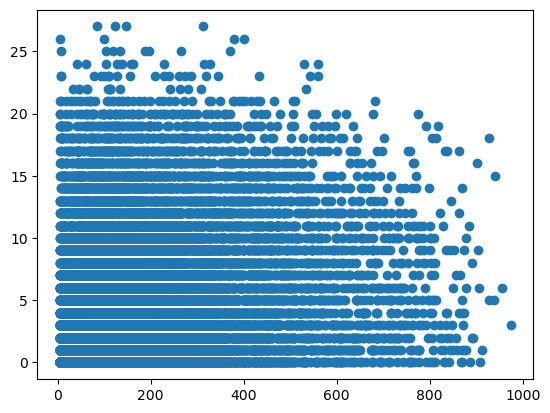

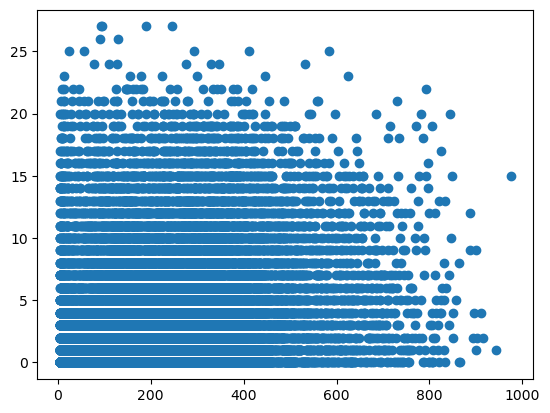

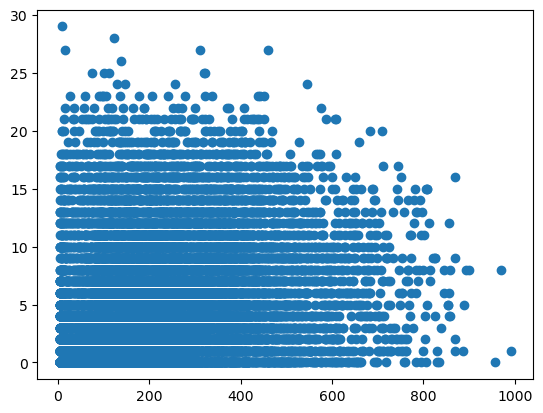

In [122]:
plt.scatter(s1m6l,v1m6l)
plt.show()
plt.scatter(s1m9l,v1m9l)
plt.show()
plt.scatter(s1m12l,v1m12l)
plt.show()

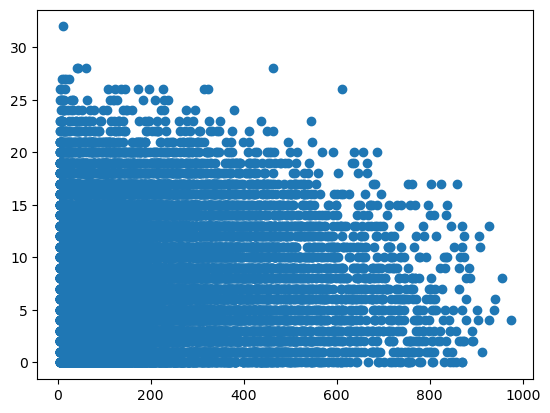

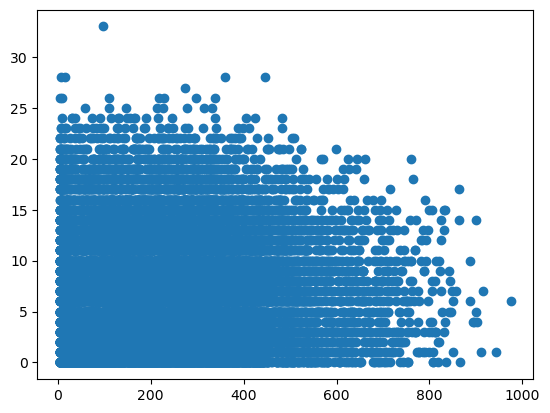

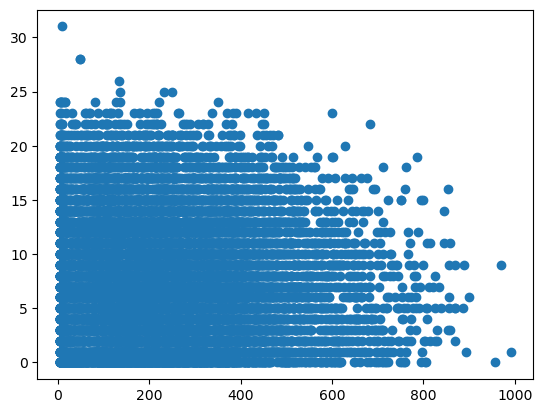

In [123]:
plt.scatter(s1m6l,v1m6fl)
plt.show()
plt.scatter(s1m9l,v1m9fl)
plt.show()
plt.scatter(s1m12l,v1m12fl)
plt.show()

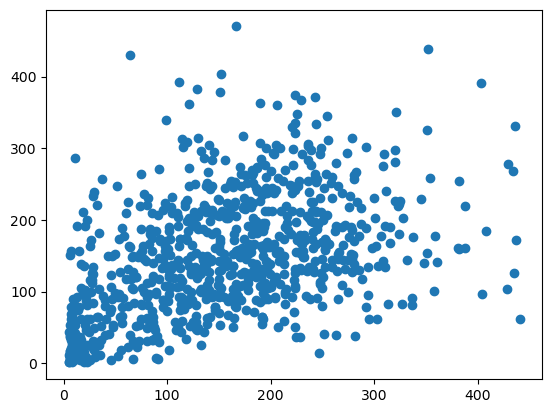

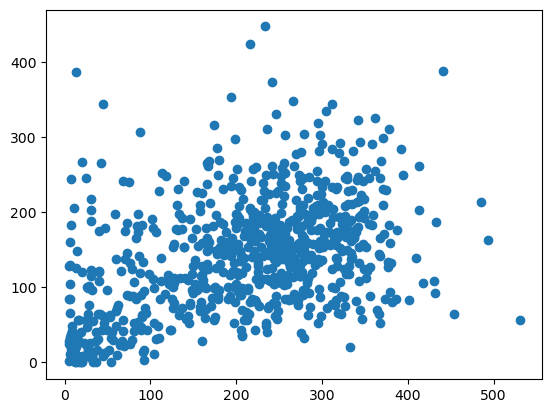

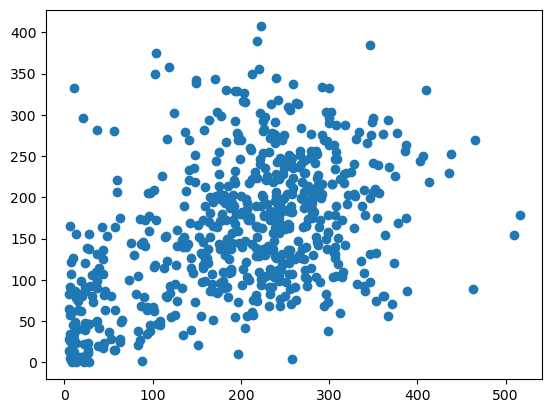

In [124]:
plt.scatter(s30m6l,v30m6l)
plt.show()
plt.scatter(s30m9l,v30m9l)
plt.show()
plt.scatter(s30m12l,v30m12l)
plt.show()

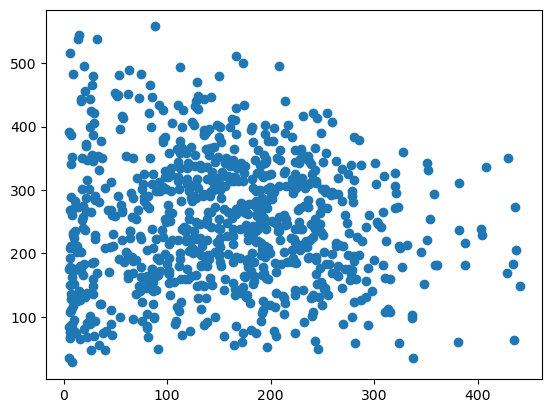

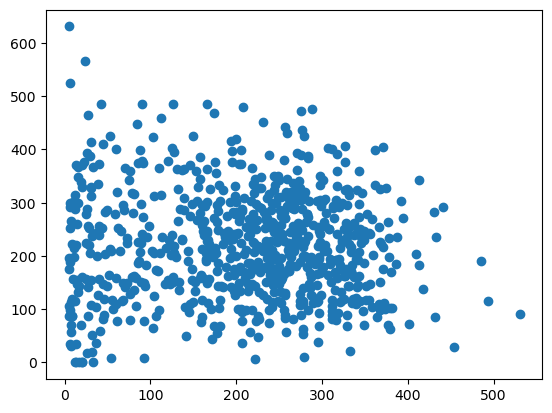

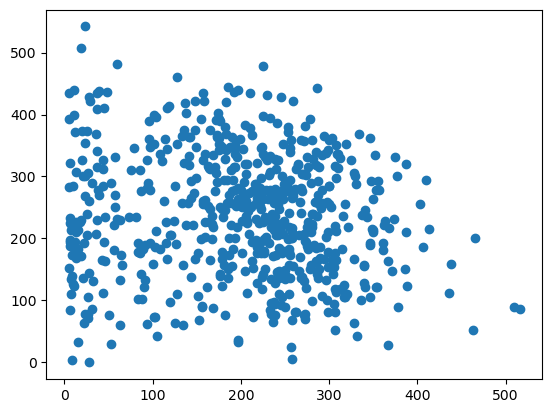

In [125]:
plt.scatter(s30m6l,v30m6fl)
plt.show()
plt.scatter(s30m9l,v30m9fl)
plt.show()
plt.scatter(s30m12l,v30m12fl)
plt.show()

In [126]:
def individual(vin,vfin,sin):
    cout=np.zeros((len(sin)))
    pout=np.zeros((len(sin)))
    coutf=np.zeros((len(sin)))
    poutf=np.zeros((len(sin)))
    for i in range(len(sin)):
        cout[i], pout[i] = pearsonr(sin[i],vin[i])
        coutf[i], poutf[i] = pearsonr(sin[i],vfin[i])
    return cout,pout,coutf,poutf

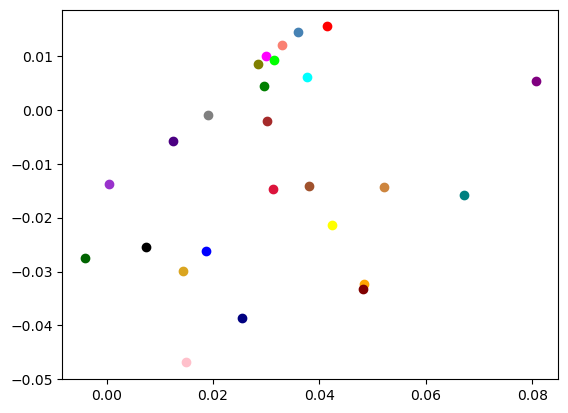

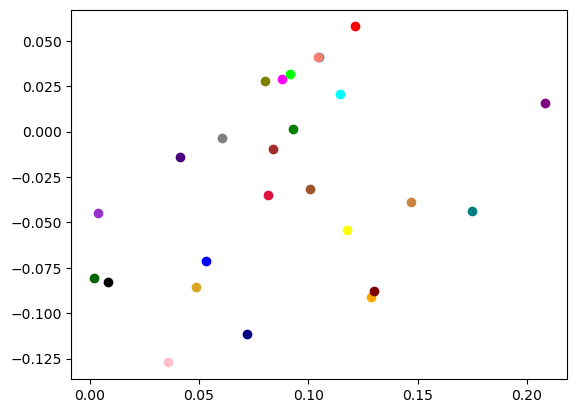

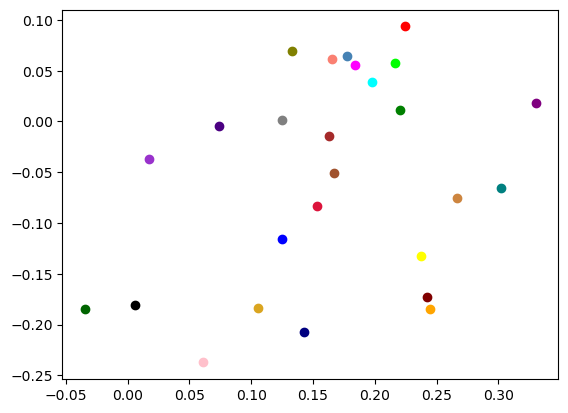

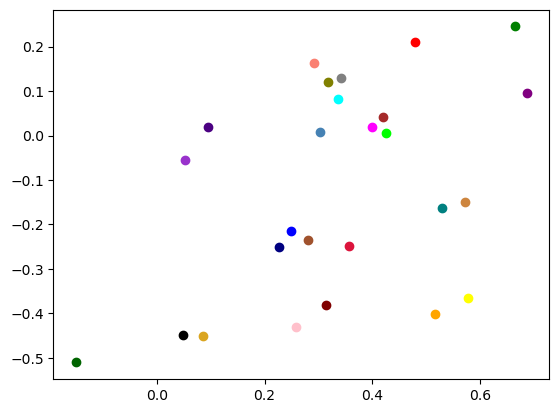

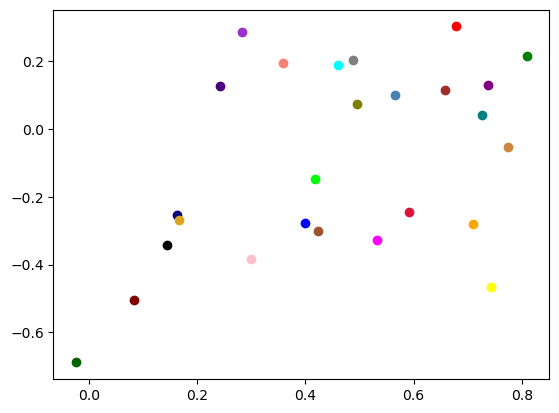

In [127]:

colorsall = ['blue', 'green', 'red', 'purple', 'orange', 'brown', 'pink',
          'gray', 'olive', 'cyan', 'magenta', 'yellow', 'black', 'teal',
          'maroon', 'navy', 'lime', 'sienna', 'indigo', 'goldenrod',
          'darkgreen', 'steelblue', 'crimson', 'salmon', 'darkorchid', 'peru']
cout1s6,pout1s6,coutf1s6,poutf1s6=individual(v1s6os,v1s6fos,s1s6os)
num_points = len(cout1s6)
for i in range(num_points):
    plt.scatter(cout1s6[i], coutf1s6[i], color=colorsall[i])
plt.show()
cout10s6,pout10s6,coutf10s6,poutf10s6=individual(v10s6os,v10s6fos,s10s6os)
for i in range(num_points):
    plt.scatter(cout10s6[i], coutf10s6[i], color=colorsall[i])
plt.show()
cout1m6,pout1m6,coutf1m6,poutf1m6=individual(v1m6os,v1m6fos,s1m6os)
for i in range(num_points):
    plt.scatter(cout1m6[i], coutf1m6[i], color=colorsall[i])
plt.show()
cout10m6,pout10m6,coutf10m6,poutf10m6=individual(v10m6os,v10m6fos,s10m6os)
for i in range(num_points):
    plt.scatter(cout10m6[i], coutf10m6[i], color=colorsall[i])
plt.show()
cout30m6,pout30m6,coutf30m6,poutf30m6=individual(v30m6os,v30m6fos,s30m6os)
for i in range(num_points):
    plt.scatter(cout30m6[i], coutf30m6[i], color=colorsall[i])
plt.show()

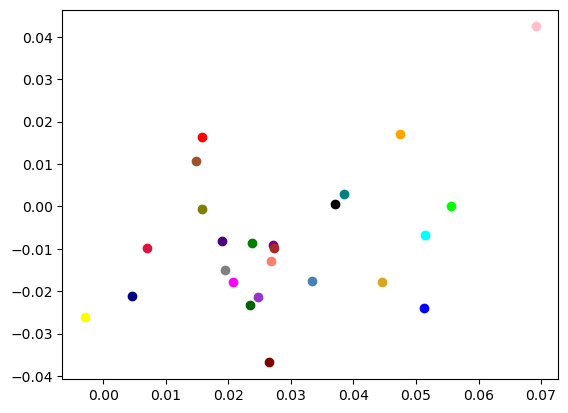

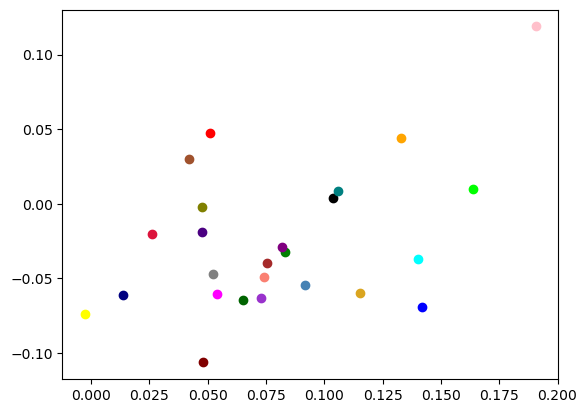

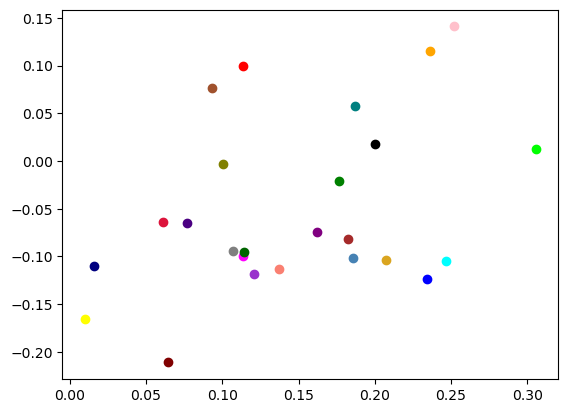

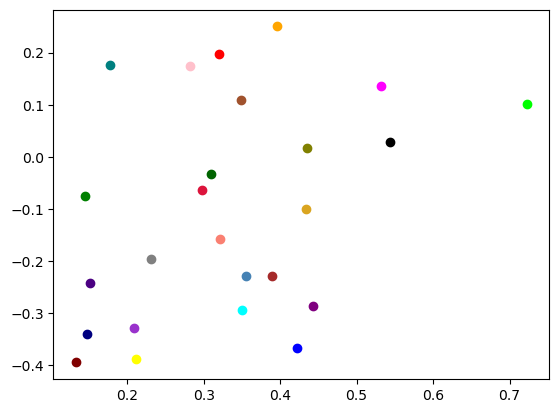

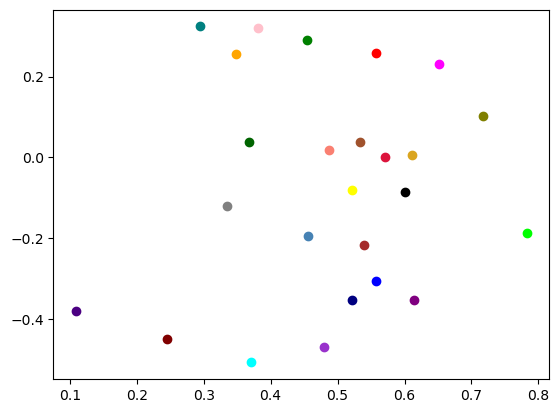

In [128]:

colorsall = ['blue', 'green', 'red', 'purple', 'orange', 'brown', 'pink',
          'gray', 'olive', 'cyan', 'magenta', 'yellow', 'black', 'teal',
          'maroon', 'navy', 'lime', 'sienna', 'indigo', 'goldenrod',
          'darkgreen', 'steelblue', 'crimson', 'salmon', 'darkorchid', 'peru']
cout1s9,pout1s9,coutf1s9,poutf1s9=individual(v1s9os,v1s9fos,s1s9os)
num_points = len(cout1s9)
for i in range(num_points):
    plt.scatter(cout1s9[i], coutf1s9[i], color=colorsall[i])
plt.show()
cout10s9,pout10s9,coutf10s9,poutf10s9=individual(v10s9os,v10s9fos,s10s9os)
for i in range(num_points):
    plt.scatter(cout10s9[i], coutf10s9[i], color=colorsall[i])
plt.show()
cout1m9,pout1m9,coutf1m9,poutf1m9=individual(v1m9os,v1m9fos,s1m9os)
for i in range(num_points):
    plt.scatter(cout1m9[i], coutf1m9[i], color=colorsall[i])
plt.show()
cout10m9,pout10m9,coutf10m9,poutf10m9=individual(v10m9os,v10m9fos,s10m9os)
for i in range(num_points):
    plt.scatter(cout10m9[i], coutf10m9[i], color=colorsall[i])
plt.show()
cout30m9,pout30m9,coutf30m9,poutf30m9=individual(v30m9os,v30m9fos,s30m9os)
for i in range(num_points):
    plt.scatter(cout30m9[i], coutf30m9[i], color=colorsall[i])
plt.show()

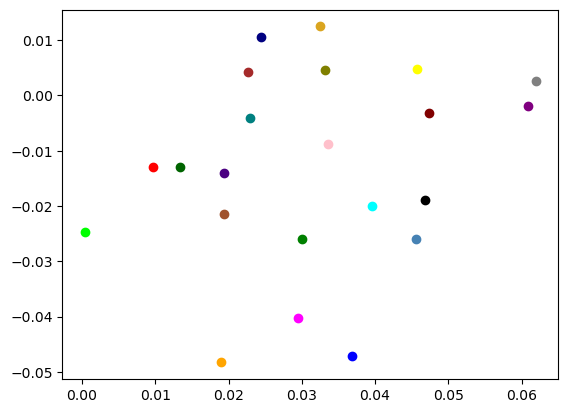

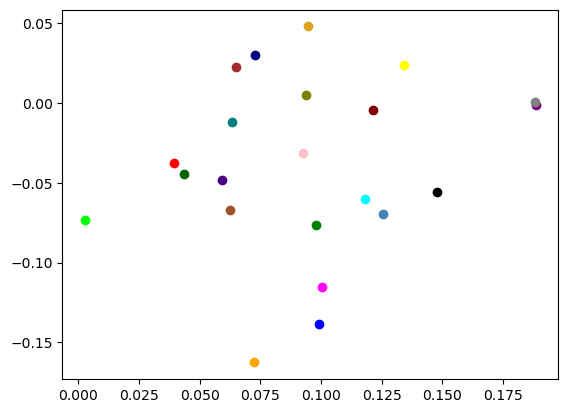

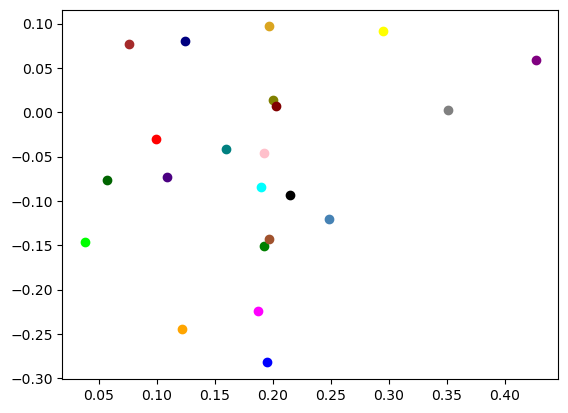

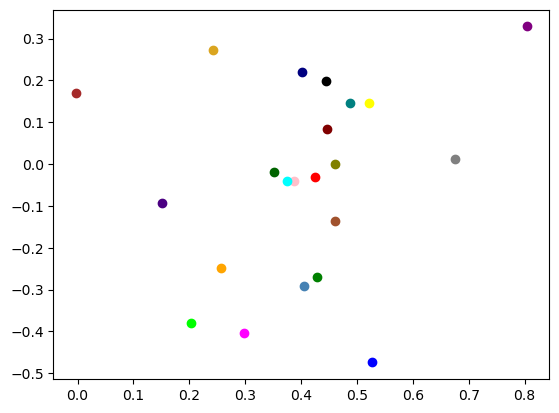

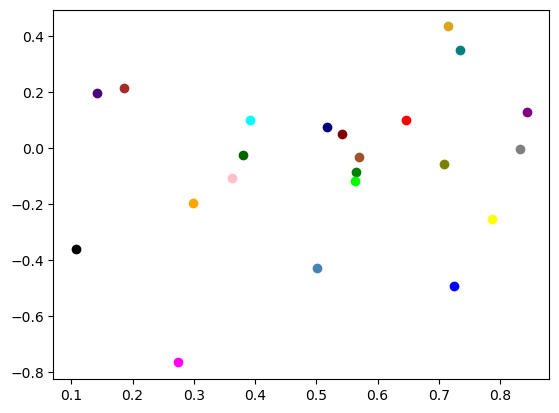

In [129]:

colorsall = ['blue', 'green', 'red', 'purple', 'orange', 'brown', 'pink',
          'gray', 'olive', 'cyan', 'magenta', 'yellow', 'black', 'teal',
          'maroon', 'navy', 'lime', 'sienna', 'indigo', 'goldenrod',
          'darkgreen', 'steelblue', 'crimson', 'salmon', 'darkorchid', 'peru']
cout1s12,pout1s12,coutf1s12,poutf1s12=individual(v1s12os,v1s12fos,s1s12os)
num_points = len(cout1s12)
for i in range(num_points):
    plt.scatter(cout1s12[i], coutf1s12[i], color=colorsall[i])
plt.show()
cout10s12,pout10s12,coutf10s12,poutf10s12=individual(v10s12os,v10s12fos,s10s12os)
for i in range(num_points):
    plt.scatter(cout10s12[i], coutf10s12[i], color=colorsall[i])
plt.show()
cout1m12,pout1m12,coutf1m12,poutf1m12=individual(v1m12os,v1m12fos,s1m12os)
for i in range(num_points):
    plt.scatter(cout1m12[i], coutf1m12[i], color=colorsall[i])
plt.show()
cout10m12,pout10m12,coutf10m12,poutf10m12=individual(v10m12os,v10m12fos,s10m12os)
for i in range(num_points):
    plt.scatter(cout10m12[i], coutf10m12[i], color=colorsall[i])
plt.show()
cout30m12,pout30m12,coutf30m12,poutf30m12=individual(v30m12os,v30m12fos,s30m12os)
for i in range(num_points):
    plt.scatter(cout30m12[i], coutf30m12[i], color=colorsall[i])
plt.show()

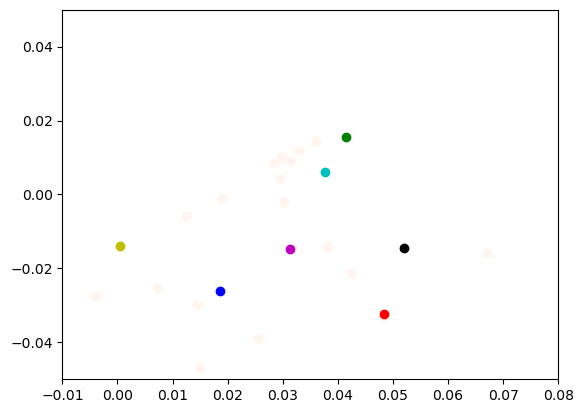

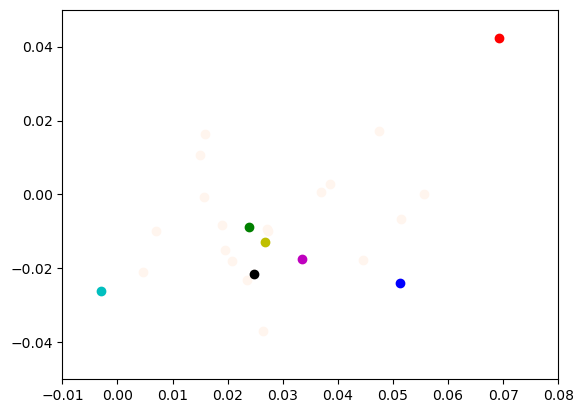

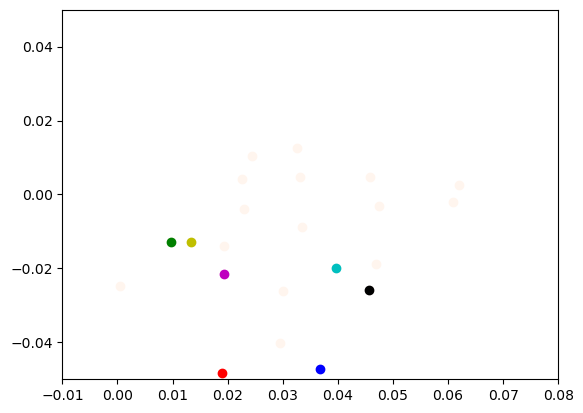

In [130]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']
plt.scatter(cout1s6, coutf1s6,color='seashell')
#plt.scatter(cout1s9, coutf1s9,color='seashell')
#plt.scatter(cout1s12, coutf1s12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(cout1s6[id6],coutf1s6[id6],c=color[i])
plt.xlim(-0.01,0.08)
plt.ylim(-0.05,0.05)
plt.show()
plt.scatter(cout1s9, coutf1s9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(cout1s9[id9],coutf1s9[id9],c=color[i])
plt.xlim(-0.01,0.08)
plt.ylim(-0.05,0.05)
plt.show()
plt.scatter(cout1s12, coutf1s12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(cout1s12[id12],coutf1s12[id12],c=color[i])
plt.xlim(-0.01,0.08)
plt.ylim(-0.05,0.05)
plt.show()

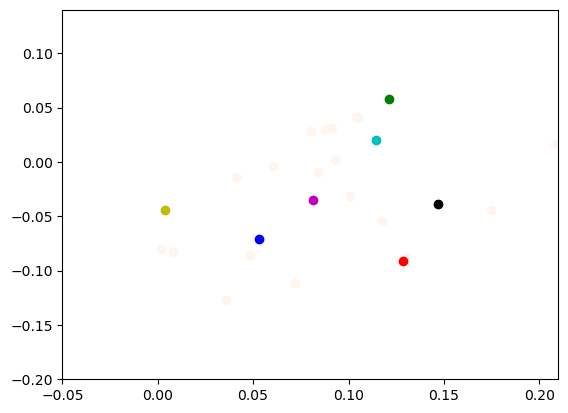

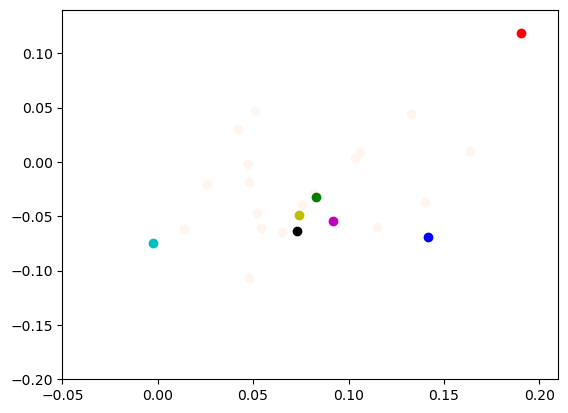

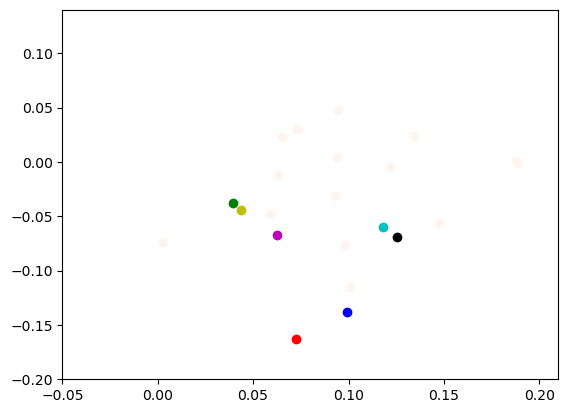

In [131]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']
plt.scatter(cout10s6, coutf10s6,color='seashell')
#plt.scatter(cout1s9, coutf1s9,color='seashell')
#plt.scatter(cout1s12, coutf1s12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(cout10s6[id6],coutf10s6[id6],c=color[i])
plt.ylim(-0.2,0.14)
plt.xlim(-0.05,0.21)
plt.show()
plt.scatter(cout10s9, coutf10s9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(cout10s9[id9],coutf10s9[id9],c=color[i])
plt.ylim(-0.2,0.14)
plt.xlim(-0.05,0.21)
plt.show()
plt.scatter(cout10s12, coutf10s12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(cout10s12[id12],coutf10s12[id12],c=color[i])
plt.ylim(-0.2,0.14)
plt.xlim(-0.05,0.21)
plt.show()

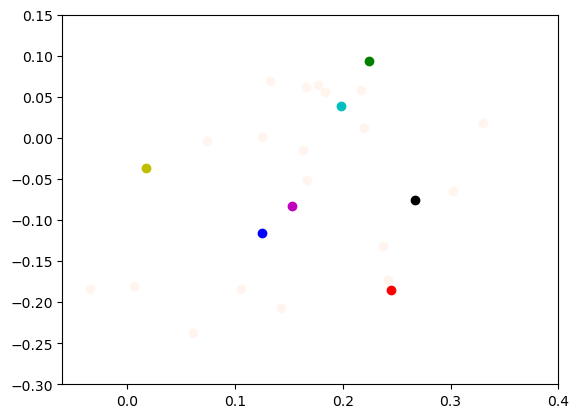

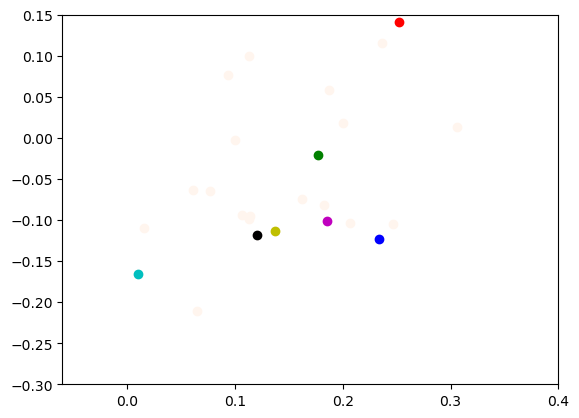

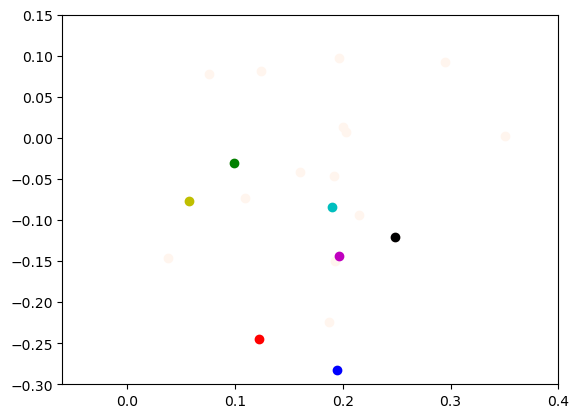

In [132]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']
plt.scatter(cout1m6, coutf1m6,color='seashell')
#plt.scatter(cout1s9, coutf1s9,color='seashell')
#plt.scatter(cout1s12, coutf1s12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(cout1m6[id6],coutf1m6[id6],c=color[i])
plt.xlim(-0.06,0.4)
plt.ylim(-0.3,0.15)
plt.show()
plt.scatter(cout1m9, coutf1m9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(cout1m9[id9],coutf1m9[id9],c=color[i])
plt.xlim(-0.06,0.4)
plt.ylim(-0.3,0.15)
plt.show()
plt.scatter(cout1m12, coutf1m12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(cout1m12[id12],coutf1m12[id12],c=color[i])
plt.xlim(-0.06,0.4)
plt.ylim(-0.3,0.15)
plt.show()

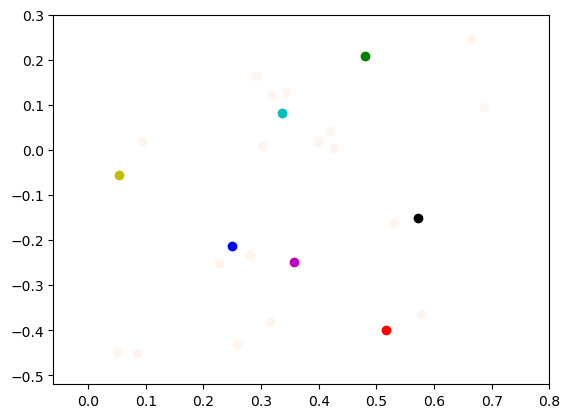

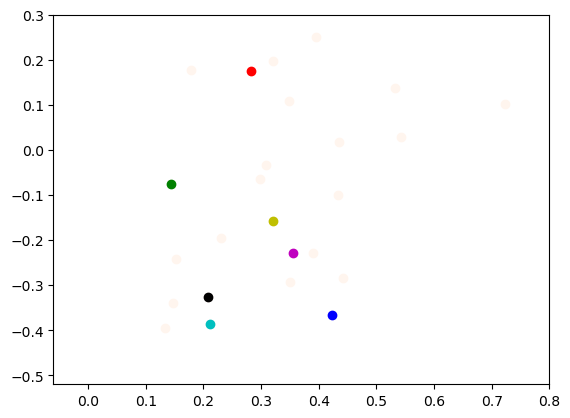

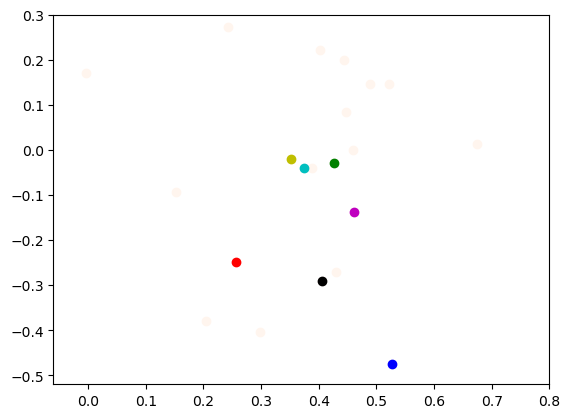

In [133]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']
plt.scatter(cout10m6, coutf10m6,color='seashell')
#plt.scatter(cout1s9, coutf1s9,color='seashell')
#plt.scatter(cout1s12, coutf1s12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(cout10m6[id6],coutf10m6[id6],c=color[i])
plt.xlim(-0.06,0.8)
plt.ylim(-0.52,0.3)
plt.show()
plt.scatter(cout10m9, coutf10m9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(cout10m9[id9],coutf10m9[id9],c=color[i])
plt.xlim(-0.06,0.8)
plt.ylim(-0.52,0.3)
plt.show()
plt.scatter(cout10m12, coutf10m12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(cout10m12[id12],coutf10m12[id12],c=color[i])
plt.xlim(-0.06,0.8)
plt.ylim(-0.52,0.3)
plt.show()

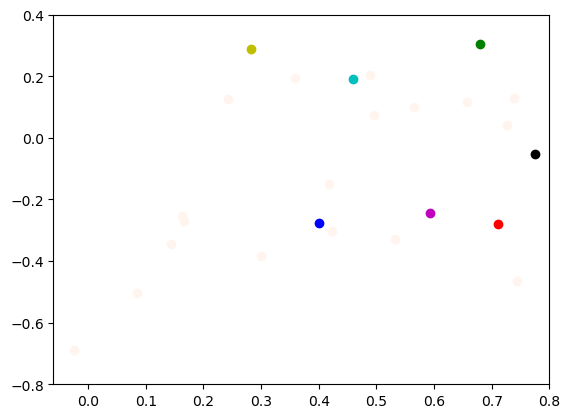

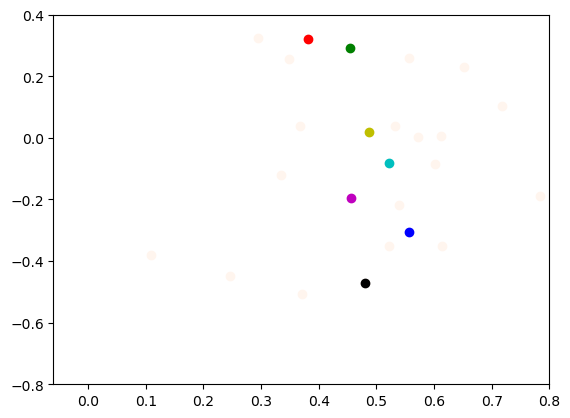

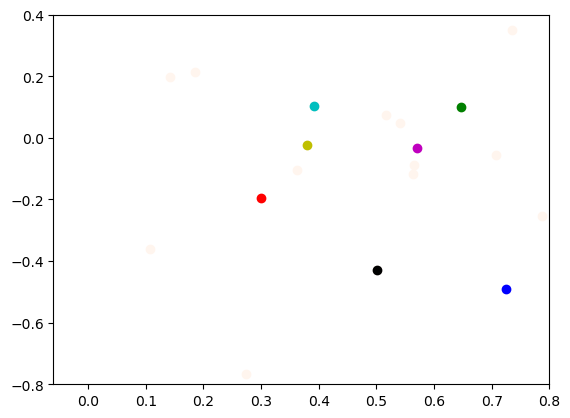

In [134]:
color=['b','g','r','c','m','y','k','brown',
      'cadeblue','orange','springgreen','purple','gray','cyan','navy','pink']
plt.scatter(cout30m6, coutf30m6,color='seashell')
#plt.scatter(cout1s9, coutf1s9,color='seashell')
#plt.scatter(cout1s12, coutf1s12,color='seashell')
for i in range(len(matchidall)):
    id6=matchidall[i][0][0]
    plt.scatter(cout30m6[id6],coutf30m6[id6],c=color[i])
plt.xlim(-0.06,0.8)
plt.ylim(-0.8,0.4)
plt.show()
plt.scatter(cout30m9, coutf30m9,color='seashell')
for i in range(len(matchidall)):
    id9=matchidall[i][0][1]
    plt.scatter(cout30m9[id9],coutf30m9[id9],c=color[i])
plt.xlim(-0.06,0.8)
plt.ylim(-0.8,0.4)
plt.show()
plt.scatter(cout30m12, coutf30m12,color='seashell')
for i in range(len(matchidall)):
    id12=matchidall[i][0][2]
    plt.scatter(cout30m12[id12],coutf30m12[id12],c=color[i])
plt.xlim(-0.06,0.8)
plt.ylim(-0.8,0.4)
plt.show()